<a href="https://colab.research.google.com/github/nattntn/DataPreparation_ForDeeptooth/blob/main/Thesis/Thesis_Polygon.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Import data set (เรียกใช้ CSV)

In [ ]:
import pandas as pd
import shutil
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import io
import cv2
import PIL
import os
import glob
import numpy as np
import sys


In [ ]:
#เชื่อม google drive
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


# path original

In [ ]:
original= pd.read_csv (r'/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_tooth/Model/Multi_task(Age)(7-25)/Table_test_Predict.csv')

# load data from CVAT

## 10Y

In [ ]:
# โหลดไฟล์ JSON
import json
with open("/content/gdrive/MyDrive/DentDiscovering/UpperSecondMolar/Polygon/10Y.json", "r") as file:
    data = json.load(file)


In [ ]:
import pandas as pd

# สร้าง DataFrame สำหรับแต่ละส่วน
categories_df = pd.DataFrame(data["categories"])
images_df = pd.DataFrame(data["images"])
annotations_df = pd.DataFrame(data["annotations"])

# รวมข้อมูลจากทุก DataFrame
combined_data = annotations_df.merge(
    categories_df, how="left", left_on="category_id", right_on="id"
).merge(
    images_df, how="left", left_on="image_id", right_on="id", suffixes=("_category", "_image")
)

# ลบคอลัมน์ที่ซ้ำซ้อนหรือไม่จำเป็น
final_combined_table = combined_data.drop(
    columns=["id", "license", "flickr_url", "coco_url", "date_captured"]#"id_category", "id_image",
)

# แสดง DataFrame ที่รวมแล้ว
print("Final Combined Table:")
final_combined_table


Final Combined Table:


,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,supercategory,width,height,file_name
0,1,1,1,"[[300.4, 240.1, 335.7, 211.4, 359.7, 223.6, 34...",1790.0,"[300.4, 211.4, 59.3, 56.9]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipH76.jpg
1,2,1,2,"[[355.23, 222.72, 352.53, 227.08, 350.87, 229....",2408.0,"[295.09, 209.25, 61.38, 74.44]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipH76.jpg
2,3,2,2,"[[349.84, 217.84, 347.26, 228.16, 344.68, 234....",1863.0,"[297.81, 201.9, 52.03, 52.06]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipH79.jpg
3,4,2,1,"[[288.4, 223.3, 326.7, 263.7, 359.1, 212.1, 33...",2560.0,"[288.4, 190.4, 70.7, 73.3]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipH79.jpg
4,5,3,1,"[[297.1, 246.2, 351.6, 263.3, 365.58, 211.03, ...",2441.0,"[297.1, 202.01, 68.48, 61.29]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipH80.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61,62,31,1,"[[275.33, 234.61, 316.6, 261.27, 352.72, 194.6...",3091.0,"[275.33, 180.43, 77.39, 80.84]",0,{'occluded': False},1,Alveolar bone,,614,518,HH94.jpg
62,63,32,1,"[[347.56, 253.1, 299.4, 223.0, 347.13, 174.41,...",3246.0,"[299.4, 174.41, 82.13, 78.69]",0,{'occluded': False},1,Alveolar bone,,614,518,HH95.jpg
63,64,32,2,"[[366.5, 180.8, 367.5, 187.4, 366.9, 193.4, 36...",1892.0,"[313.1, 174.1, 54.4, 65.11]",0,{'occluded': False},2,Upper Second Molar,,614,518,HH95.jpg
64,65,33,2,"[[319.5, 227.3, 316.72, 232.71, 315.88, 236.9,...",2545.0,"[256.99, 212.6, 62.51, 75.4]",0,{'occluded': False},2,Upper Second Molar,,614,581,HH96.jpg


In [ ]:
 aa =  pd.merge(final_combined_table, original, left_on='file_name', right_on='Filename', how='inner')
 aa

,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,...,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,1,1,1,"[[300.4, 240.1, 335.7, 211.4, 359.7, 223.6, 34...",1790.0,"[300.4, 211.4, 59.3, 56.9]",0,{'occluded': False},1,Alveolar bone,...,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipH76.jpg,0,Female,9.528455,10.0,0.000011,Female,0.0
1,2,1,2,"[[355.23, 222.72, 352.53, 227.08, 350.87, 229....",2408.0,"[295.09, 209.25, 61.38, 74.44]",0,{'occluded': False},2,Upper Second Molar,...,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipH76.jpg,0,Female,9.528455,10.0,0.000011,Female,0.0
2,3,2,2,"[[349.84, 217.84, 347.26, 228.16, 344.68, 234....",1863.0,"[297.81, 201.9, 52.03, 52.06]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipH79.jpg,0,Female,9.548588,10.0,0.993093,Male,1.0
3,4,2,1,"[[288.4, 223.3, 326.7, 263.7, 359.1, 212.1, 33...",2560.0,"[288.4, 190.4, 70.7, 73.3]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipH79.jpg,0,Female,9.548588,10.0,0.993093,Male,1.0
4,5,3,1,"[[297.1, 246.2, 351.6, 263.3, 365.58, 211.03, ...",2441.0,"[297.1, 202.01, 68.48, 61.29]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipH80.jpg,0,Female,10.282820,10.0,0.000614,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61,62,31,1,"[[275.33, 234.61, 316.6, 261.27, 352.72, 194.6...",3091.0,"[275.33, 180.43, 77.39, 80.84]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,HH94.jpg,1,Male,9.642025,10.0,0.999995,Male,1.0
62,63,32,1,"[[347.56, 253.1, 299.4, 223.0, 347.13, 174.41,...",3246.0,"[299.4, 174.41, 82.13, 78.69]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,HH95.jpg,1,Male,9.317166,9.0,0.198161,Female,0.0
63,64,32,2,"[[366.5, 180.8, 367.5, 187.4, 366.9, 193.4, 36...",1892.0,"[313.1, 174.1, 54.4, 65.11]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,HH95.jpg,1,Male,9.317166,9.0,0.198161,Female,0.0
64,65,33,2,"[[319.5, 227.3, 316.72, 232.71, 315.88, 236.9,...",2545.0,"[256.99, 212.6, 62.51, 75.4]",0,{'occluded': False},2,Upper Second Molar,...,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,HH96.jpg,1,Male,10.084106,10.0,0.992403,Male,1.0


In [ ]:
set(aa['Age(year)'])

{10}

In [ ]:
len(set(aa['file_name']))

33

In [ ]:
aa.columns

Index(['id_x', 'image_id', 'category_id', 'segmentation', 'area', 'bbox',
       'iscrowd', 'attributes', 'id_y', 'name', 'supercategory', 'width',
       'height', 'file_name', 'Unnamed: 0', 'Age(year)', 'Gender',
       'Folder_type', 'Folder_name', 'Path_Name', 'Filename', 'Gender_Class',
       'Gender_Predict', 'Age_predict', 'Age_predict_int', 'Gender_predict',
       'Gender_predict_str', 'Gender_predict_int'],
      dtype='object')

## 11Y

In [ ]:
# โหลดไฟล์ JSON
import json
with open("/content/gdrive/MyDrive/DentDiscovering/UpperSecondMolar/Polygon/11Y.json", "r") as file:
    data = json.load(file)


In [ ]:
import pandas as pd

# สร้าง DataFrame สำหรับแต่ละส่วน
categories_df = pd.DataFrame(data["categories"])
images_df = pd.DataFrame(data["images"])
annotations_df = pd.DataFrame(data["annotations"])

# รวมข้อมูลจากทุก DataFrame
combined_data = annotations_df.merge(
    categories_df, how="left", left_on="category_id", right_on="id"
).merge(
    images_df, how="left", left_on="image_id", right_on="id", suffixes=("_category", "_image")
)

# ลบคอลัมน์ที่ซ้ำซ้อนหรือไม่จำเป็น
final_combined_table = combined_data.drop(
    columns=["id", "license", "flickr_url", "coco_url", "date_captured"]#"id_category", "id_image",
)

# แสดง DataFrame ที่รวมแล้ว
print("Final Combined Table:")
final_combined_table


Final Combined Table:


,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,supercategory,width,height,file_name
0,1,1,2,"[[309.7, 301.7, 310.3, 296.5, 307.9, 296.6, 30...",2283.0,"[260.0, 289.4, 50.3, 73.87]",0,{'occluded': False},2,Upper Second Molar,,614,654,D78.jpg
1,2,1,1,"[[251.23, 342.0, 306.13, 355.43, 311.97, 294.1...",2944.0,"[251.23, 280.67, 60.74, 74.76]",0,{'occluded': False},1,Alveolar bone,,614,654,D78.jpg
2,3,2,2,"[[352.1, 205.1, 351.46, 207.58, 350.64, 210.38...",2307.0,"[294.47, 195.27, 57.93, 75.88]",0,{'occluded': False},2,Upper Second Molar,,614,518,D79.jpg
3,4,2,1,"[[286.72, 251.43, 330.26, 275.82, 361.62, 204....",3374.0,"[286.72, 188.23, 74.9, 87.59]",0,{'occluded': False},1,Alveolar bone,,614,518,D79.jpg
4,5,3,2,"[[352.5, 191.0, 352.2, 193.1, 351.6, 195.1, 35...",1775.0,"[302.16, 183.6, 50.34, 56.3]",0,{'occluded': False},2,Upper Second Molar,,614,518,D83.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77,78,39,2,"[[326.1, 202.6, 323.4, 200.8, 320.8, 204.1, 31...",2324.0,"[273.5, 199.85, 52.8, 67.35]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipDD118.jpg
78,79,40,1,"[[276.94, 223.1, 327.74, 240.3, 350.22, 168.69...",3633.0,"[276.94, 153.7, 73.28, 86.6]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipDD121.jpg
79,80,40,2,"[[338.0, 169.2, 340.8, 173.9, 340.3, 179.3, 33...",2450.0,"[282.2, 164.2, 58.6, 75.37]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipDD121.jpg
80,81,41,2,"[[326.9, 188.1, 326.04, 191.67, 324.8, 194.4, ...",2290.0,"[260.9, 180.7, 66.0, 59.28]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipDD95.jpg


In [ ]:
 aa =  pd.merge(final_combined_table, original, left_on='file_name', right_on='Filename', how='inner')
 aa

,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,...,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,1,1,2,"[[309.7, 301.7, 310.3, 296.5, 307.9, 296.6, 30...",2283.0,"[260.0, 289.4, 50.3, 73.87]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,D78.jpg,0,Female,9.843965,10.0,0.004832,Female,0.0
1,2,1,1,"[[251.23, 342.0, 306.13, 355.43, 311.97, 294.1...",2944.0,"[251.23, 280.67, 60.74, 74.76]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,D78.jpg,0,Female,9.843965,10.0,0.004832,Female,0.0
2,3,2,2,"[[352.1, 205.1, 351.46, 207.58, 350.64, 210.38...",2307.0,"[294.47, 195.27, 57.93, 75.88]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,D79.jpg,0,Female,10.546963,11.0,0.000011,Female,0.0
3,4,2,1,"[[286.72, 251.43, 330.26, 275.82, 361.62, 204....",3374.0,"[286.72, 188.23, 74.9, 87.59]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,D79.jpg,0,Female,10.546963,11.0,0.000011,Female,0.0
4,5,3,2,"[[352.5, 191.0, 352.2, 193.1, 351.6, 195.1, 35...",1775.0,"[302.16, 183.6, 50.34, 56.3]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,D83.jpg,0,Female,9.684315,10.0,0.999993,Male,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77,78,39,2,"[[326.1, 202.6, 323.4, 200.8, 320.8, 204.1, 31...",2324.0,"[273.5, 199.85, 52.8, 67.35]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipDD118.jpg,1,Male,9.594864,10.0,0.999877,Male,1.0
78,79,40,1,"[[276.94, 223.1, 327.74, 240.3, 350.22, 168.69...",3633.0,"[276.94, 153.7, 73.28, 86.6]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipDD121.jpg,1,Male,9.645771,10.0,0.999998,Male,1.0
79,80,40,2,"[[338.0, 169.2, 340.8, 173.9, 340.3, 179.3, 33...",2450.0,"[282.2, 164.2, 58.6, 75.37]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipDD121.jpg,1,Male,9.645771,10.0,0.999998,Male,1.0
80,81,41,2,"[[326.9, 188.1, 326.04, 191.67, 324.8, 194.4, ...",2290.0,"[260.9, 180.7, 66.0, 59.28]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipDD95.jpg,1,Male,10.354521,10.0,1.000000,Male,1.0


In [ ]:
set(aa['Age(year)'])

{11}

In [ ]:
len(set(aa['file_name']))

41

In [ ]:
aa.columns

Index(['id_x', 'image_id', 'category_id', 'segmentation', 'area', 'bbox',
       'iscrowd', 'attributes', 'id_y', 'name', 'supercategory', 'width',
       'height', 'file_name', 'Unnamed: 0', 'Age(year)', 'Gender',
       'Folder_type', 'Folder_name', 'Path_Name', 'Filename', 'Gender_Class',
       'Gender_Predict', 'Age_predict', 'Age_predict_int', 'Gender_predict',
       'Gender_predict_str', 'Gender_predict_int'],
      dtype='object')

## 12Y

In [ ]:
# โหลดไฟล์ JSON
import json
with open("/content/gdrive/MyDrive/DentDiscovering/UpperSecondMolar/Polygon/12Y.json", "r") as file:
    data = json.load(file)


In [ ]:
import pandas as pd

# สร้าง DataFrame สำหรับแต่ละส่วน
categories_df = pd.DataFrame(data["categories"])
images_df = pd.DataFrame(data["images"])
annotations_df = pd.DataFrame(data["annotations"])

# รวมข้อมูลจากทุก DataFrame
combined_data = annotations_df.merge(
    categories_df, how="left", left_on="category_id", right_on="id"
).merge(
    images_df, how="left", left_on="image_id", right_on="id", suffixes=("_category", "_image")
)

# ลบคอลัมน์ที่ซ้ำซ้อนหรือไม่จำเป็น
final_combined_table = combined_data.drop(
    columns=["id", "license", "flickr_url", "coco_url", "date_captured"]#"id_category", "id_image",
)

# แสดง DataFrame ที่รวมแล้ว
print("Final Combined Table:")
final_combined_table


Final Combined Table:


,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,supercategory,width,height,file_name
0,1,1,2,"[[314.3, 202.6, 314.7, 206.0, 314.79, 209.04, ...",2208.0,"[262.12, 196.9, 52.67, 64.39]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipO85.jpg
1,2,1,1,"[[257.4, 223.59, 317.36, 248.54, 325.52, 190.0...",2583.0,"[257.4, 183.79, 68.12, 64.75]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipO85.jpg
2,3,2,2,"[[339.3, 198.6, 342.6, 201.6, 343.0, 206.1, 34...",2330.0,"[284.9, 195.2, 58.1, 67.46]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipO86.jpg
3,4,2,1,"[[282.22, 229.72, 328.51, 260.03, 348.83, 201....",2476.0,"[282.22, 188.09, 66.61, 71.94]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipO86.jpg
4,5,3,2,"[[362.2, 209.1, 364.9, 212.2, 365.2, 215.5, 36...",2368.0,"[291.4, 205.4, 73.8, 65.8]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipO91.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69,70,35,1,"[[330.92, 229.83, 279.32, 198.87, 334.88, 157....",2987.0,"[279.32, 157.98, 84.97, 71.85]",0,{'occluded': False},1,Alveolar bone,,614,518,OO117.jpg
70,71,36,2,"[[331.6, 199.4, 329.9, 194.0, 326.6, 197.9, 32...",2213.0,"[266.89, 191.3, 64.71, 62.8]",0,{'occluded': False},2,Upper Second Molar,,614,518,OO98.jpg
71,72,36,1,"[[318.88, 237.57, 273.3, 201.45, 311.57, 171.3...",2519.0,"[273.3, 171.36, 74.82, 66.21]",0,{'occluded': False},1,Alveolar bone,,614,518,OO98.jpg
72,73,37,2,"[[355.6, 198.3, 356.4, 201.1, 355.7, 203.8, 35...",2037.0,"[297.2, 185.1, 59.2, 67.4]",0,{'occluded': False},2,Upper Second Molar,,614,518,OO99.jpg


In [ ]:
 aa =  pd.merge(final_combined_table, original, left_on='file_name', right_on='Filename', how='inner')
 aa

,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,...,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,1,1,2,"[[314.3, 202.6, 314.7, 206.0, 314.79, 209.04, ...",2208.0,"[262.12, 196.9, 52.67, 64.39]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipO85.jpg,0,Female,11.971212,12.0,0.943920,Male,1.0
1,2,1,1,"[[257.4, 223.59, 317.36, 248.54, 325.52, 190.0...",2583.0,"[257.4, 183.79, 68.12, 64.75]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipO85.jpg,0,Female,11.971212,12.0,0.943920,Male,1.0
2,3,2,2,"[[339.3, 198.6, 342.6, 201.6, 343.0, 206.1, 34...",2330.0,"[284.9, 195.2, 58.1, 67.46]",0,{'occluded': False},2,Upper Second Molar,...,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipO86.jpg,0,Female,10.931463,11.0,0.000353,Female,0.0
3,4,2,1,"[[282.22, 229.72, 328.51, 260.03, 348.83, 201....",2476.0,"[282.22, 188.09, 66.61, 71.94]",0,{'occluded': False},1,Alveolar bone,...,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipO86.jpg,0,Female,10.931463,11.0,0.000353,Female,0.0
4,5,3,2,"[[362.2, 209.1, 364.9, 212.2, 365.2, 215.5, 36...",2368.0,"[291.4, 205.4, 73.8, 65.8]",0,{'occluded': False},2,Upper Second Molar,...,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipO91.jpg,0,Female,11.112968,11.0,0.000260,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69,70,35,1,"[[330.92, 229.83, 279.32, 198.87, 334.88, 157....",2987.0,"[279.32, 157.98, 84.97, 71.85]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,OO117.jpg,1,Male,12.406982,12.0,0.967986,Male,1.0
70,71,36,2,"[[331.6, 199.4, 329.9, 194.0, 326.6, 197.9, 32...",2213.0,"[266.89, 191.3, 64.71, 62.8]",0,{'occluded': False},2,Upper Second Molar,...,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,OO98.jpg,1,Male,12.105593,12.0,0.044166,Female,0.0
71,72,36,1,"[[318.88, 237.57, 273.3, 201.45, 311.57, 171.3...",2519.0,"[273.3, 171.36, 74.82, 66.21]",0,{'occluded': False},1,Alveolar bone,...,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,OO98.jpg,1,Male,12.105593,12.0,0.044166,Female,0.0
72,73,37,2,"[[355.6, 198.3, 356.4, 201.1, 355.7, 203.8, 35...",2037.0,"[297.2, 185.1, 59.2, 67.4]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,OO99.jpg,1,Male,9.715018,10.0,0.009757,Female,0.0


In [ ]:
set(aa['Age(year)'])

{12}

In [ ]:
len(set(aa['file_name']))

37

In [ ]:
aa.columns

Index(['id_x', 'image_id', 'category_id', 'segmentation', 'area', 'bbox',
       'iscrowd', 'attributes', 'id_y', 'name', 'supercategory', 'width',
       'height', 'file_name', 'Unnamed: 0', 'Age(year)', 'Gender',
       'Folder_type', 'Folder_name', 'Path_Name', 'Filename', 'Gender_Class',
       'Gender_Predict', 'Age_predict', 'Age_predict_int', 'Gender_predict',
       'Gender_predict_str', 'Gender_predict_int'],
      dtype='object')

## 13Y

In [ ]:
# โหลดไฟล์ JSON
import json
with open("/content/gdrive/MyDrive/DentDiscovering/UpperSecondMolar/Polygon/13Y.json", "r") as file:
    data = json.load(file)


In [ ]:
import pandas as pd

# สร้าง DataFrame สำหรับแต่ละส่วน
categories_df = pd.DataFrame(data["categories"])
images_df = pd.DataFrame(data["images"])
annotations_df = pd.DataFrame(data["annotations"])

# รวมข้อมูลจากทุก DataFrame
combined_data = annotations_df.merge(
    categories_df, how="left", left_on="category_id", right_on="id"
).merge(
    images_df, how="left", left_on="image_id", right_on="id", suffixes=("_category", "_image")
)

# ลบคอลัมน์ที่ซ้ำซ้อนหรือไม่จำเป็น
final_combined_table = combined_data.drop(
    columns=["id", "license", "flickr_url", "coco_url", "date_captured"]#"id_category", "id_image",
)

# แสดง DataFrame ที่รวมแล้ว
print("Final Combined Table:")
final_combined_table


Final Combined Table:


,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,supercategory,width,height,file_name
0,1,1,2,"[[340.0, 218.2, 339.56, 222.98, 339.9, 226.1, ...",2712.0,"[277.11, 214.3, 62.89, 85.9]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipG101.jpg
1,2,1,1,"[[323.68, 281.38, 284.05, 256.74, 323.68, 207....",2567.0,"[284.05, 207.44, 69.28, 73.94]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipG101.jpg
2,3,2,2,"[[311.1, 198.9, 309.9, 202.5, 309.03, 206.33, ...",2294.0,"[246.0, 192.5, 65.2, 70.45]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipG103.jpg
3,4,2,1,"[[296.19, 248.31, 243.69, 227.03, 293.88, 186....",2420.0,"[243.69, 186.32, 76.79, 61.99]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipG103.jpg
4,5,3,1,"[[325.58, 270.59, 279.29, 245.94, 322.92, 210....",2098.0,"[279.29, 210.64, 68.61, 59.95]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipG105.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81,82,41,2,"[[314.92, 181.77, 315.97, 184.94, 316.82, 188....",2471.0,"[269.0, 179.9, 48.24, 83.9]",0,{'occluded': False},2,Upper Second Molar,,614,518,GG138.jpg
82,83,42,1,"[[329.56, 260.21, 290.79, 243.03, 317.57, 192....",2180.0,"[290.79, 192.27, 56.76, 67.94]",0,{'occluded': False},1,Alveolar bone,,614,518,GG139.jpg
83,84,42,2,"[[328.87, 211.57, 326.75, 211.14, 325.06, 213....",2088.0,"[283.9, 209.03, 46.02, 76.51]",0,{'occluded': False},2,Upper Second Molar,,614,518,GG139.jpg
84,85,43,2,"[[319.1, 223.5, 320.2, 226.0, 321.0, 228.4, 32...",1735.0,"[281.31, 218.1, 40.69, 66.0]",0,{'occluded': False},2,Upper Second Molar,,614,518,GG140.jpg


In [ ]:
 aa =  pd.merge(final_combined_table, original, left_on='file_name', right_on='Filename', how='inner')
 aa

,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,...,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,1,1,2,"[[340.0, 218.2, 339.56, 222.98, 339.9, 226.1, ...",2712.0,"[277.11, 214.3, 62.89, 85.9]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipG101.jpg,0,Female,13.745493,14.0,0.002789,Female,0.0
1,2,1,1,"[[323.68, 281.38, 284.05, 256.74, 323.68, 207....",2567.0,"[284.05, 207.44, 69.28, 73.94]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipG101.jpg,0,Female,13.745493,14.0,0.002789,Female,0.0
2,3,2,2,"[[311.1, 198.9, 309.9, 202.5, 309.03, 206.33, ...",2294.0,"[246.0, 192.5, 65.2, 70.45]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipG103.jpg,0,Female,11.992689,12.0,0.983669,Male,1.0
3,4,2,1,"[[296.19, 248.31, 243.69, 227.03, 293.88, 186....",2420.0,"[243.69, 186.32, 76.79, 61.99]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipG103.jpg,0,Female,11.992689,12.0,0.983669,Male,1.0
4,5,3,1,"[[325.58, 270.59, 279.29, 245.94, 322.92, 210....",2098.0,"[279.29, 210.64, 68.61, 59.95]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipG105.jpg,0,Female,13.723455,14.0,0.002447,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81,82,41,2,"[[314.92, 181.77, 315.97, 184.94, 316.82, 188....",2471.0,"[269.0, 179.9, 48.24, 83.9]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,GG138.jpg,1,Male,13.992902,14.0,0.996932,Male,1.0
82,83,42,1,"[[329.56, 260.21, 290.79, 243.03, 317.57, 192....",2180.0,"[290.79, 192.27, 56.76, 67.94]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,GG139.jpg,1,Male,12.359261,12.0,0.156407,Female,0.0
83,84,42,2,"[[328.87, 211.57, 326.75, 211.14, 325.06, 213....",2088.0,"[283.9, 209.03, 46.02, 76.51]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,GG139.jpg,1,Male,12.359261,12.0,0.156407,Female,0.0
84,85,43,2,"[[319.1, 223.5, 320.2, 226.0, 321.0, 228.4, 32...",1735.0,"[281.31, 218.1, 40.69, 66.0]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,GG140.jpg,1,Male,13.248869,13.0,0.932267,Male,1.0


In [ ]:
set(aa['Age(year)'])

{13}

In [ ]:
len(set(aa['file_name']))

43

In [ ]:
aa.columns

Index(['id_x', 'image_id', 'category_id', 'segmentation', 'area', 'bbox',
       'iscrowd', 'attributes', 'id_y', 'name', 'supercategory', 'width',
       'height', 'file_name', 'Unnamed: 0', 'Age(year)', 'Gender',
       'Folder_type', 'Folder_name', 'Path_Name', 'Filename', 'Gender_Class',
       'Gender_Predict', 'Age_predict', 'Age_predict_int', 'Gender_predict',
       'Gender_predict_str', 'Gender_predict_int'],
      dtype='object')

## 14Y

In [ ]:
# โหลดไฟล์ JSON
import json
with open("/content/gdrive/MyDrive/DentDiscovering/UpperSecondMolar/Polygon/14Y.json", "r") as file:
    data = json.load(file)


In [ ]:
import pandas as pd

# สร้าง DataFrame สำหรับแต่ละส่วน
categories_df = pd.DataFrame(data["categories"])
images_df = pd.DataFrame(data["images"])
annotations_df = pd.DataFrame(data["annotations"])

# รวมข้อมูลจากทุก DataFrame
combined_data = annotations_df.merge(
    categories_df, how="left", left_on="category_id", right_on="id"
).merge(
    images_df, how="left", left_on="image_id", right_on="id", suffixes=("_category", "_image")
)

# ลบคอลัมน์ที่ซ้ำซ้อนหรือไม่จำเป็น
final_combined_table = combined_data.drop(
    columns=["id", "license", "flickr_url", "coco_url", "date_captured"]#"id_category", "id_image",
)

# แสดง DataFrame ที่รวมแล้ว
print("Final Combined Table:")
final_combined_table


Final Combined Table:


,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,supercategory,width,height,file_name
0,1,1,2,"[[305.9, 218.2, 308.0, 221.0, 309.69, 224.34, ...",2683.0,"[257.0, 213.9, 53.44, 84.34]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipY104.jpg
1,2,1,1,"[[305.68, 280.6, 256.38, 261.12, 290.16, 202.0...",2987.0,"[256.38, 202.08, 66.34, 78.52]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipY104.jpg
2,3,2,2,"[[296.4, 224.4, 296.96, 227.49, 297.17, 231.02...",2338.0,"[253.9, 223.35, 46.8, 78.17]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipY187.jpg
3,4,2,1,"[[306.08, 279.42, 257.13, 262.93, 279.19, 212....",2385.0,"[257.13, 212.21, 53.0, 67.21]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipY187.jpg
4,5,3,1,"[[340.28, 283.49, 289.46, 264.93, 333.89, 216....",2685.0,"[289.46, 216.84, 76.69, 66.65]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipY188.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79,80,40,2,"[[353.9, 218.6, 352.53, 223.14, 351.4, 225.9, ...",2345.0,"[298.0, 209.5, 55.9, 84.97]",0,{'occluded': False},2,Upper Second Molar,,614,518,Y282.jpg
80,81,41,2,"[[334.8, 243.2, 335.0, 245.5, 335.3, 247.4, 33...",1845.0,"[294.64, 236.2, 42.86, 64.7]",0,{'occluded': False},2,Upper Second Molar,,614,518,Y96.jpg
81,82,41,1,"[[344.29, 278.68, 296.14, 263.63, 322.37, 214....",2493.0,"[296.14, 214.18, 65.35, 64.5]",0,{'occluded': False},1,Alveolar bone,,614,518,Y96.jpg
82,83,42,2,"[[335.94, 243.84, 336.63, 246.6, 336.63, 249.3...",1866.0,"[287.21, 238.14, 49.42, 66.35]",0,{'occluded': False},2,Upper Second Molar,,614,518,Y98.jpg


In [ ]:
 aa =  pd.merge(final_combined_table, original, left_on='file_name', right_on='Filename', how='inner')
 aa

,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,...,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,1,1,2,"[[305.9, 218.2, 308.0, 221.0, 309.69, 224.34, ...",2683.0,"[257.0, 213.9, 53.44, 84.34]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipY104.jpg,0,Female,14.686197,15.0,0.100597,Female,0.0
1,2,1,1,"[[305.68, 280.6, 256.38, 261.12, 290.16, 202.0...",2987.0,"[256.38, 202.08, 66.34, 78.52]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipY104.jpg,0,Female,14.686197,15.0,0.100597,Female,0.0
2,3,2,2,"[[296.4, 224.4, 296.96, 227.49, 297.17, 231.02...",2338.0,"[253.9, 223.35, 46.8, 78.17]",0,{'occluded': False},2,Upper Second Molar,...,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipY187.jpg,0,Female,13.616200,14.0,0.978944,Male,1.0
3,4,2,1,"[[306.08, 279.42, 257.13, 262.93, 279.19, 212....",2385.0,"[257.13, 212.21, 53.0, 67.21]",0,{'occluded': False},1,Alveolar bone,...,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipY187.jpg,0,Female,13.616200,14.0,0.978944,Male,1.0
4,5,3,1,"[[340.28, 283.49, 289.46, 264.93, 333.89, 216....",2685.0,"[289.46, 216.84, 76.69, 66.65]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipY188.jpg,0,Female,13.723018,14.0,0.000535,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79,80,40,2,"[[353.9, 218.6, 352.53, 223.14, 351.4, 225.9, ...",2345.0,"[298.0, 209.5, 55.9, 84.97]",0,{'occluded': False},2,Upper Second Molar,...,Rt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,Y282.jpg,1,Male,12.958851,13.0,0.866450,Male,1.0
80,81,41,2,"[[334.8, 243.2, 335.0, 245.5, 335.3, 247.4, 33...",1845.0,"[294.64, 236.2, 42.86, 64.7]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,Y96.jpg,0,Female,13.595289,14.0,0.000004,Female,0.0
81,82,41,1,"[[344.29, 278.68, 296.14, 263.63, 322.37, 214....",2493.0,"[296.14, 214.18, 65.35, 64.5]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,Y96.jpg,0,Female,13.595289,14.0,0.000004,Female,0.0
82,83,42,2,"[[335.94, 243.84, 336.63, 246.6, 336.63, 249.3...",1866.0,"[287.21, 238.14, 49.42, 66.35]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,Y98.jpg,0,Female,14.057829,14.0,0.000036,Female,0.0


In [ ]:
set(aa['Age(year)'])

{14}

In [ ]:
len(set(aa['file_name']))

42

In [ ]:
aa.columns

Index(['id_x', 'image_id', 'category_id', 'segmentation', 'area', 'bbox',
       'iscrowd', 'attributes', 'id_y', 'name', 'supercategory', 'width',
       'height', 'file_name', 'Unnamed: 0', 'Age(year)', 'Gender',
       'Folder_type', 'Folder_name', 'Path_Name', 'Filename', 'Gender_Class',
       'Gender_Predict', 'Age_predict', 'Age_predict_int', 'Gender_predict',
       'Gender_predict_str', 'Gender_predict_int'],
      dtype='object')

## 15Y

In [ ]:
# โหลดไฟล์ JSON
import json
with open("/content/gdrive/MyDrive/DentDiscovering/UpperSecondMolar/Polygon/15Y.json", "r") as file:
    data = json.load(file)


In [ ]:
import pandas as pd

# สร้าง DataFrame สำหรับแต่ละส่วน
categories_df = pd.DataFrame(data["categories"])
images_df = pd.DataFrame(data["images"])
annotations_df = pd.DataFrame(data["annotations"])

# รวมข้อมูลจากทุก DataFrame
combined_data = annotations_df.merge(
    categories_df, how="left", left_on="category_id", right_on="id"
).merge(
    images_df, how="left", left_on="image_id", right_on="id", suffixes=("_category", "_image")
)

# ลบคอลัมน์ที่ซ้ำซ้อนหรือไม่จำเป็น
final_combined_table = combined_data.drop(
    columns=["id", "license", "flickr_url", "coco_url", "date_captured"]#"id_category", "id_image",
)

# แสดง DataFrame ที่รวมแล้ว
print("Final Combined Table:")
final_combined_table


Final Combined Table:


,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,supercategory,width,height,file_name
0,1,1,2,"[[329.3, 202.93, 329.5, 209.1, 329.6, 214.8, 3...",2368.0,"[278.17, 201.2, 51.43, 82.81]",0,{'occluded': False},2,Upper Second Molar,,614,518,B148.jpg
1,2,1,1,"[[328.68, 263.4, 281.38, 242.08, 325.35, 191.7...",2487.0,"[281.38, 191.79, 67.62, 71.61]",0,{'occluded': False},1,Alveolar bone,,614,518,B148.jpg
2,3,2,1,"[[283.72, 225.01, 316.9, 263.3, 363.4, 203.4, ...",3133.0,"[283.72, 179.4, 79.68, 83.9]",0,{'occluded': False},1,Alveolar bone,,614,518,B153.jpg
3,4,2,2,"[[350.78, 193.75, 350.99, 197.13, 351.2, 200.5...",2286.0,"[290.4, 188.7, 60.8, 65.07]",0,{'occluded': False},2,Upper Second Molar,,614,518,B153.jpg
4,5,3,1,"[[359.37, 268.55, 318.54, 253.08, 349.99, 200....",2147.0,"[318.54, 200.83, 56.81, 67.72]",0,{'occluded': False},1,Alveolar bone,,614,518,B154.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83,84,42,1,"[[352.01, 253.98, 308.63, 236.88, 338.87, 192....",2255.0,"[308.63, 192.62, 65.73, 61.36]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipB334.jpg
84,85,43,2,"[[302.6, 208.4, 305.0, 209.5, 306.57, 211.18, ...",2213.0,"[266.7, 207.5, 45.22, 76.2]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipB336.jpg
85,86,43,1,"[[314.32, 265.98, 266.55, 250.64, 290.66, 199....",2436.0,"[266.55, 199.81, 56.98, 66.17]",0,{'occluded': False},1,Alveolar bone,,614,518,FlipB336.jpg
86,87,44,2,"[[355.3, 194.8, 355.8, 197.4, 355.8, 201.0, 35...",1786.0,"[306.2, 191.6, 49.6, 72.2]",0,{'occluded': False},2,Upper Second Molar,,614,518,FlipB64.jpg


In [ ]:
 aa =  pd.merge(final_combined_table, original, left_on='file_name', right_on='Filename', how='inner')
 aa

,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,...,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,1,1,2,"[[329.3, 202.93, 329.5, 209.1, 329.6, 214.8, 3...",2368.0,"[278.17, 201.2, 51.43, 82.81]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,B148.jpg,0,Female,14.368689,14.0,0.003458,Female,0.0
1,2,1,1,"[[328.68, 263.4, 281.38, 242.08, 325.35, 191.7...",2487.0,"[281.38, 191.79, 67.62, 71.61]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,B148.jpg,0,Female,14.368689,14.0,0.003458,Female,0.0
2,3,2,1,"[[283.72, 225.01, 316.9, 263.3, 363.4, 203.4, ...",3133.0,"[283.72, 179.4, 79.68, 83.9]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,B153.jpg,0,Female,15.182503,15.0,0.672907,Male,1.0
3,4,2,2,"[[350.78, 193.75, 350.99, 197.13, 351.2, 200.5...",2286.0,"[290.4, 188.7, 60.8, 65.07]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,B153.jpg,0,Female,15.182503,15.0,0.672907,Male,1.0
4,5,3,1,"[[359.37, 268.55, 318.54, 253.08, 349.99, 200....",2147.0,"[318.54, 200.83, 56.81, 67.72]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,B154.jpg,0,Female,16.764080,17.0,0.017210,Female,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83,84,42,1,"[[352.01, 253.98, 308.63, 236.88, 338.87, 192....",2255.0,"[308.63, 192.62, 65.73, 61.36]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipB334.jpg,1,Male,13.255766,13.0,0.850344,Male,1.0
84,85,43,2,"[[302.6, 208.4, 305.0, 209.5, 306.57, 211.18, ...",2213.0,"[266.7, 207.5, 45.22, 76.2]",0,{'occluded': False},2,Upper Second Molar,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipB336.jpg,1,Male,14.165010,14.0,0.888207,Male,1.0
85,86,43,1,"[[314.32, 265.98, 266.55, 250.64, 290.66, 199....",2436.0,"[266.55, 199.81, 56.98, 66.17]",0,{'occluded': False},1,Alveolar bone,...,Both,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipB336.jpg,1,Male,14.165010,14.0,0.888207,Male,1.0
86,87,44,2,"[[355.3, 194.8, 355.8, 197.4, 355.8, 201.0, 35...",1786.0,"[306.2, 191.6, 49.6, 72.2]",0,{'occluded': False},2,Upper Second Molar,...,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipB64.jpg,1,Male,13.292011,13.0,0.991763,Male,1.0


In [ ]:
set(aa['Age(year)'])

{15}

In [ ]:
len(set(aa['file_name']))

44

In [ ]:
aa.columns

Index(['id_x', 'image_id', 'category_id', 'segmentation', 'area', 'bbox',
       'iscrowd', 'attributes', 'id_y', 'name', 'supercategory', 'width',
       'height', 'file_name', 'Unnamed: 0', 'Age(year)', 'Gender',
       'Folder_type', 'Folder_name', 'Path_Name', 'Filename', 'Gender_Class',
       'Gender_Predict', 'Age_predict', 'Age_predict_int', 'Gender_predict',
       'Gender_predict_str', 'Gender_predict_int'],
      dtype='object')

# ปรับภาพ

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [219, 219, 219]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       ...,

       [[251, 251, 251],
        [240, 240, 240],
        [223, 223, 223],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[251, 251, 251],
        [242, 242, 242],
        [229, 229, 229],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[253, 253, 253],
        [247, 247, 247],
        [237, 237, 237],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]], dtype=uint8)
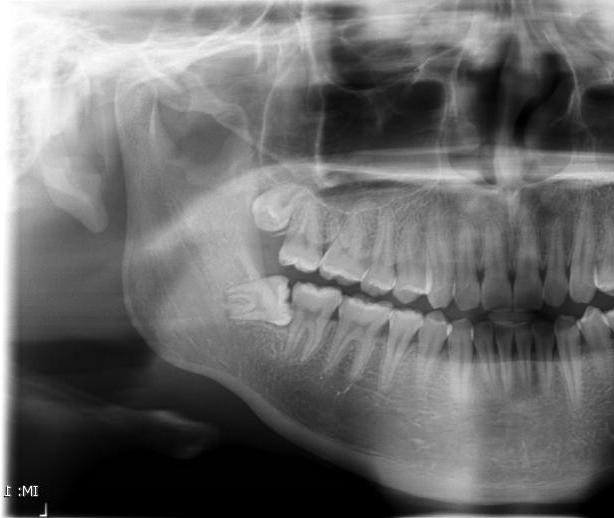

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

# โหลดภาพ
image = cv2.imread(aa['Path_Name'][0])
image

In [ ]:
aa['bbox'][0]

[278.41, 185.1, 44.09, 87.6]

In [ ]:
# ตัวอย่าง bbox
bbox = aa['bbox'][0]  # [x_min, y_min, width, height]

# แปลงค่า bbox ให้เป็นตัวเลขจำนวนเต็ม
x_min, y_min, width, height = map(int, bbox)

# ครอบภาพ
cropped_image = image[y_min:y_min + height, x_min:x_min + width]

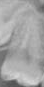

In [ ]:

# แสดงภาพที่ครอบ
cv2_imshow(cropped_image)

### การวาด segmentation บนภาพ

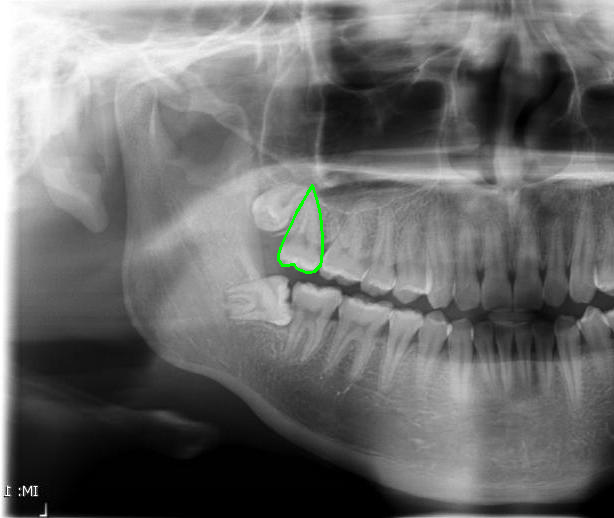

In [ ]:
import numpy as np

# ตัวอย่าง segmentation
segmentation = aa['segmentation'][0][0]  # Flattened list of points (x1, y1, x2, y2, ...)

# แปลง segmentation เป็น array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# วาด Polygon บนภาพ
image_with_polygon = image.copy()
cv2.polylines(image_with_polygon, [points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลภาพ
cv2_imshow(image_with_polygon)
# cv2.waitKey(0)
# cv2.destroyAllWindows()


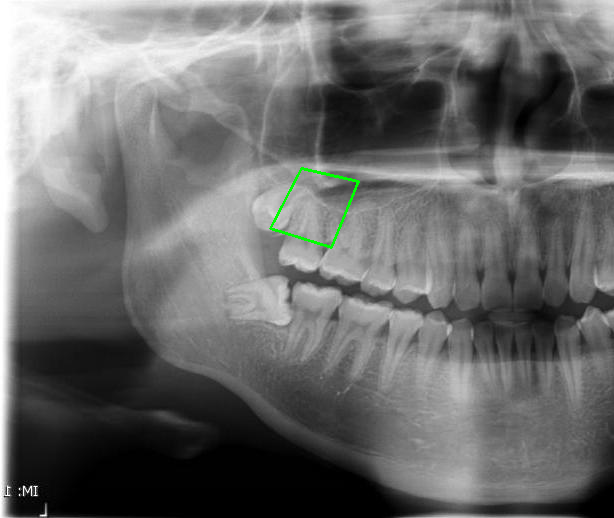

In [ ]:
import numpy as np

# ตัวอย่าง segmentation
segmentation = aa['segmentation'][1][0]  # Flattened list of points (x1, y1, x2, y2, ...)

# แปลง segmentation เป็น array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# วาด Polygon บนภาพ
image_with_polygon = image.copy()
cv2.polylines(image_with_polygon, [points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลภาพ
cv2_imshow(image_with_polygon)
# cv2.waitKey(0)
# cv2.destroyAllWindows()


การย้ายตำแหน่ง (Translation)

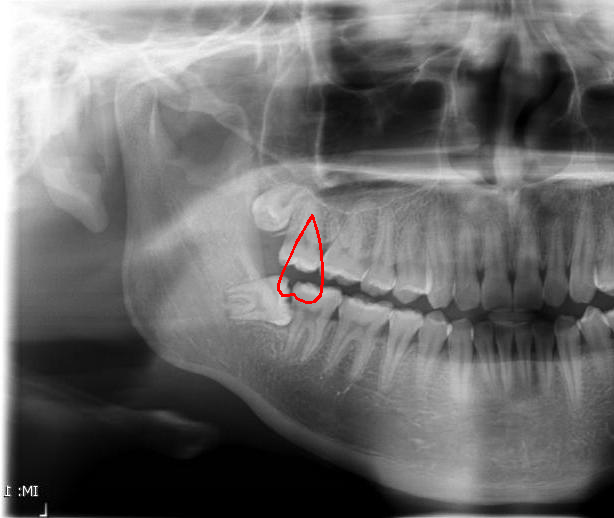

In [ ]:
# กำหนดระยะการเลื่อน
dx, dy = 0, 30  # ย้ายไปทางขวา 50 px และลงล่าง 30 px

# ย้าย Polygon
translated_points = points + [dx, dy]

# วาด Polygon ที่ตำแหน่งใหม่
image_with_translated_polygon = image.copy()
cv2.polylines(image_with_translated_polygon, [translated_points], isClosed=True, color=(0, 0, 255), thickness=2)

# แสดงผลภาพ
cv2_imshow(image_with_translated_polygon)
# cv2.waitKey(0)
# cv2.destroyAllWindows()


## try 2nd

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [219, 219, 219]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       ...,

       [[251, 251, 251],
        [240, 240, 240],
        [223, 223, 223],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[251, 251, 251],
        [242, 242, 242],
        [229, 229, 229],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[253, 253, 253],
        [247, 247, 247],
        [237, 237, 237],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]], dtype=uint8)
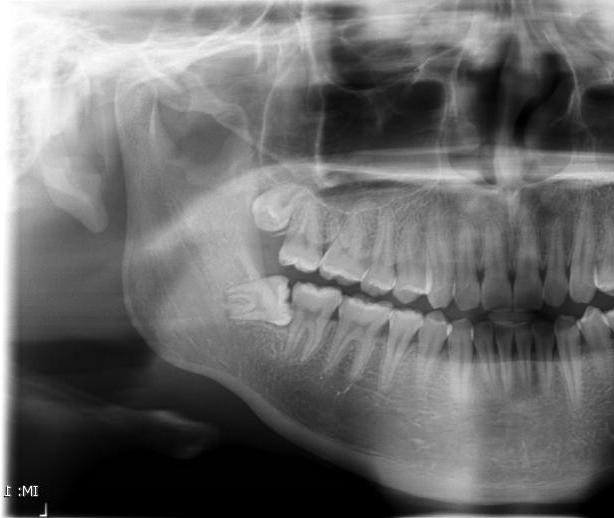

In [ ]:
image = cv2.imread(aa['Path_Name'][0])
image

# ได้จริงๆ

## poly

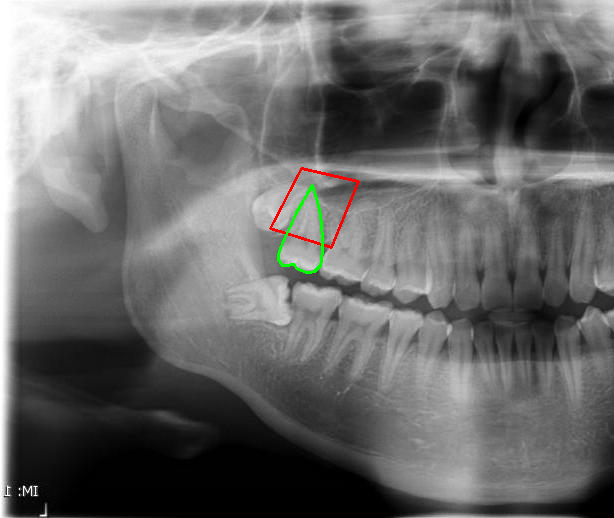

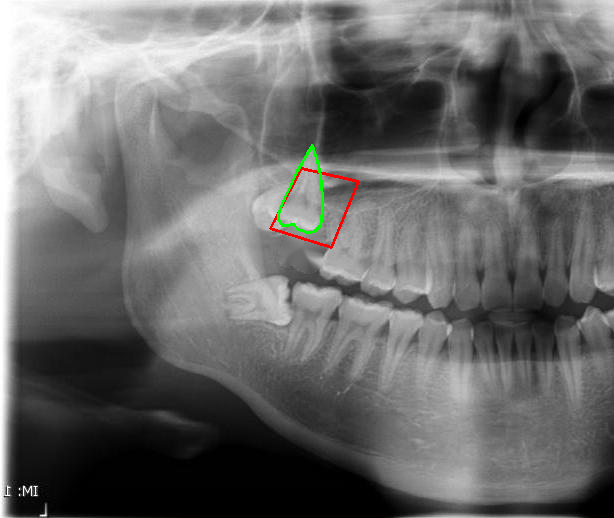

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


image_with_polygon = image.copy()

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -40  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


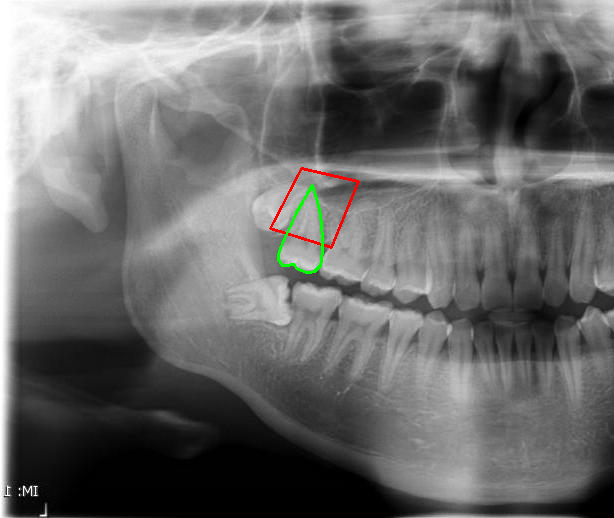

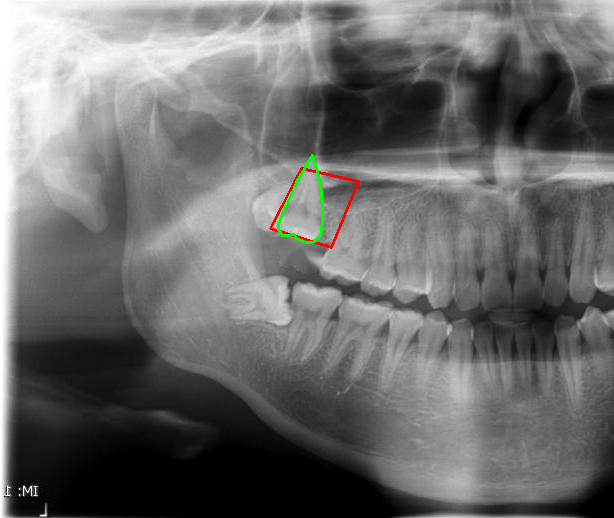

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


image_with_polygon = image.copy()

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -30  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


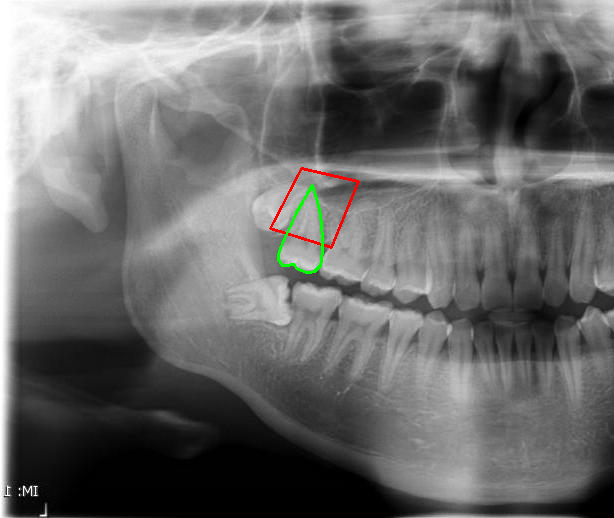

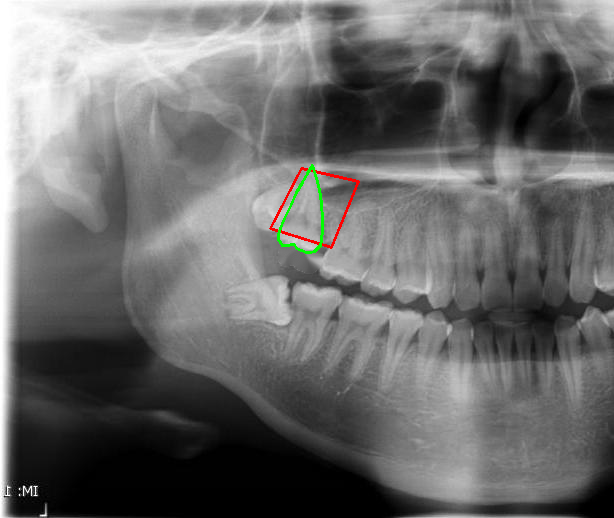

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


image_with_polygon = image.copy()

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -20  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


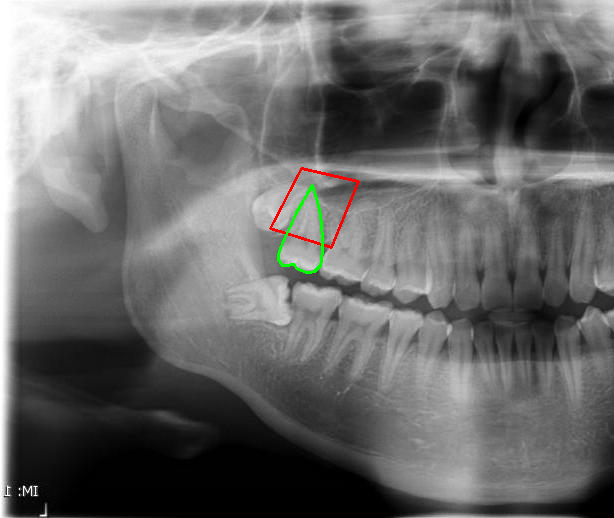

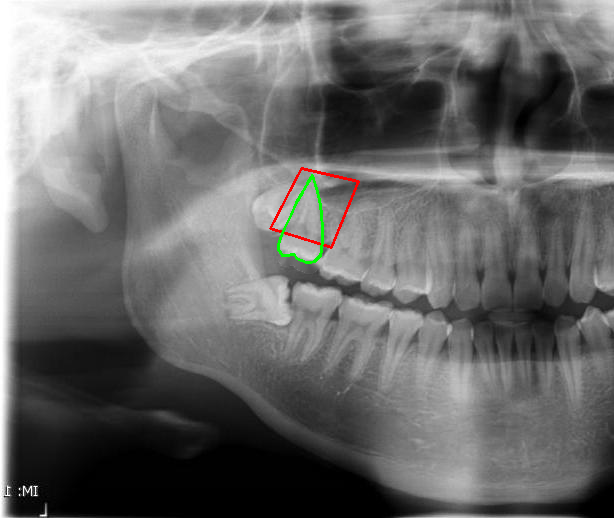

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


image_with_polygon = image.copy()

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -10  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


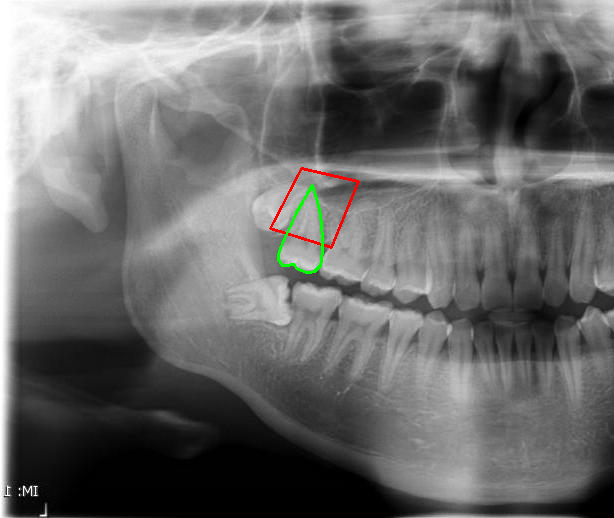

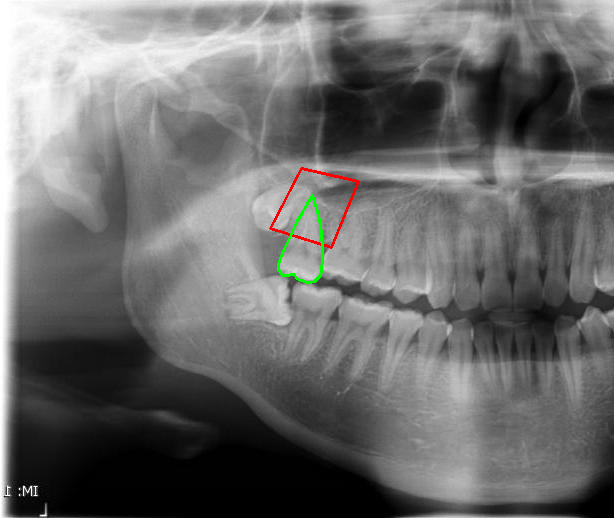

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


image_with_polygon = image.copy()

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 10  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


## non-poly

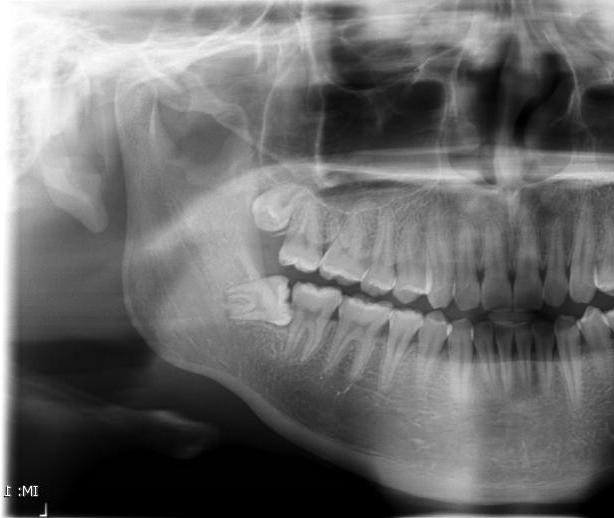

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


# image_with_polygon = image.copy()

# # # วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
# # cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# # # วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
# # cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# # แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
# cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 0  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# # วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
# cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


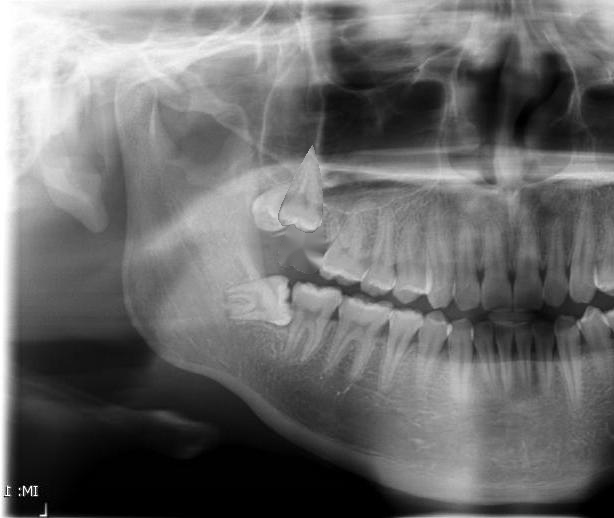

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


# image_with_polygon = image.copy()

# # # วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
# # cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# # # วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
# # cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# # แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
# cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -40  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# # วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
# cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


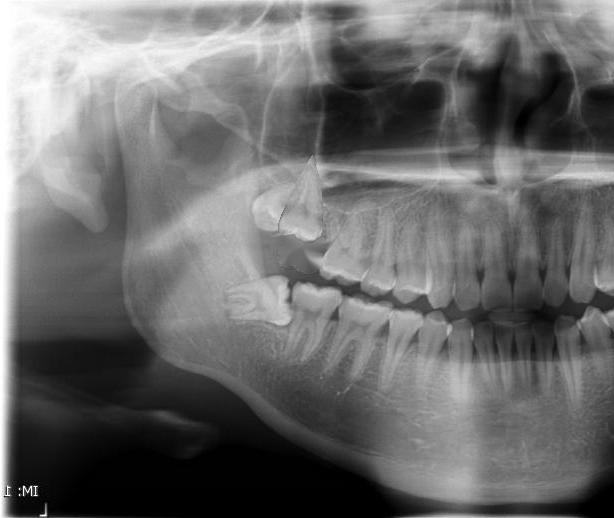

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


# image_with_polygon = image.copy()

# # วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
# cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# # วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
# cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# # แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
# cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -30  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# # วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
# cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


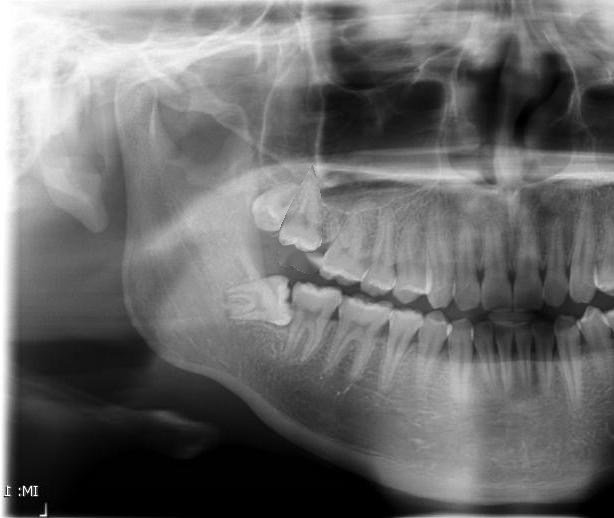

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


# image_with_polygon = image.copy()

# # วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
# cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# # วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
# cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# # แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
# cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -20  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# # วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
# cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


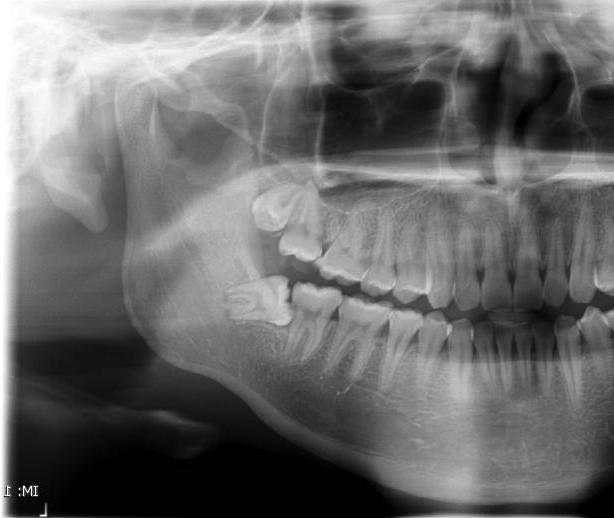

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


# image_with_polygon = image.copy()

# # วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
# cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# # วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
# cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# # แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
# cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -10  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# # วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
# cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


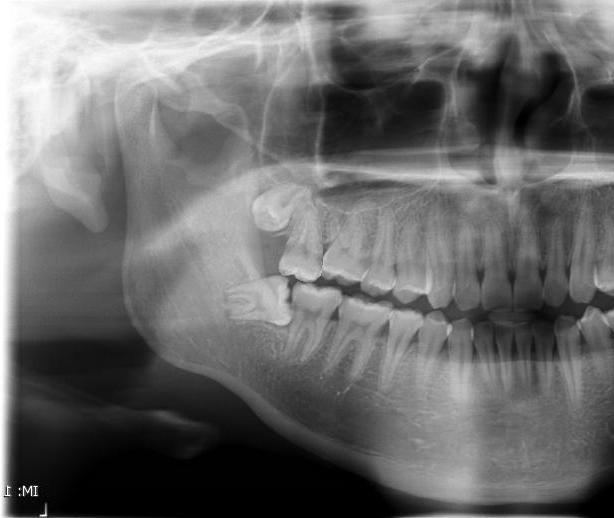

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


# image_with_polygon = image.copy()

# # วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
# cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# # วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
# cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# # แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
# cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 10  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# # วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
# cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


## apendix

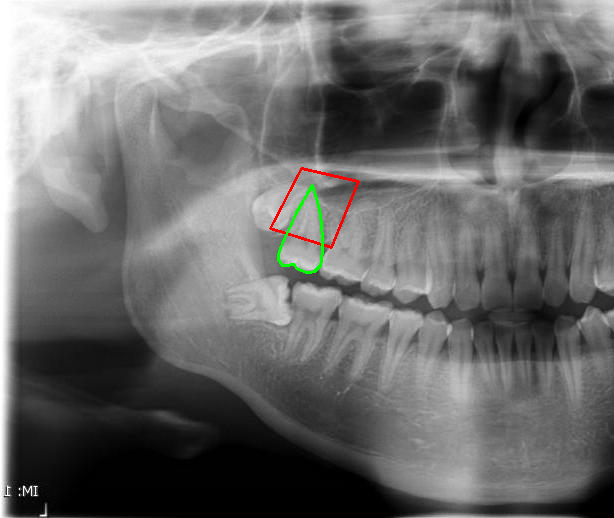

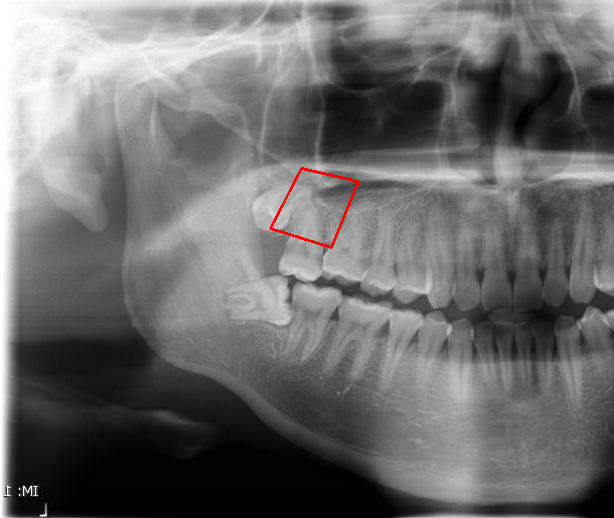

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


image_with_polygon = image.copy()

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 10  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


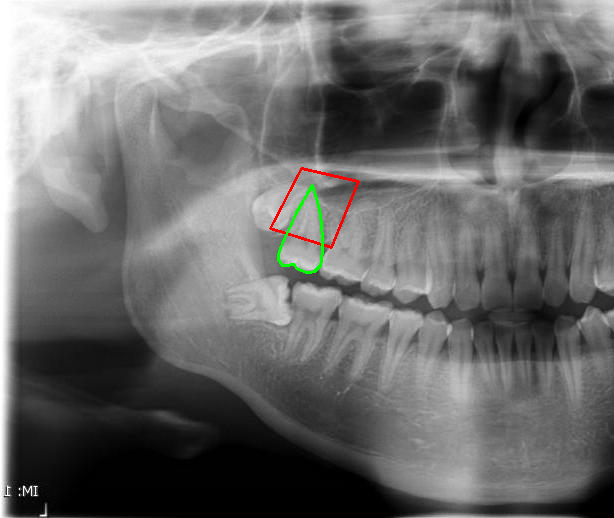

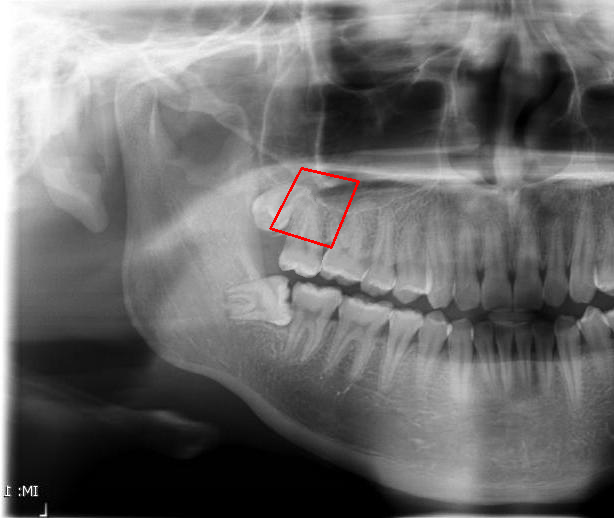

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


image_with_polygon = image.copy()

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 5  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


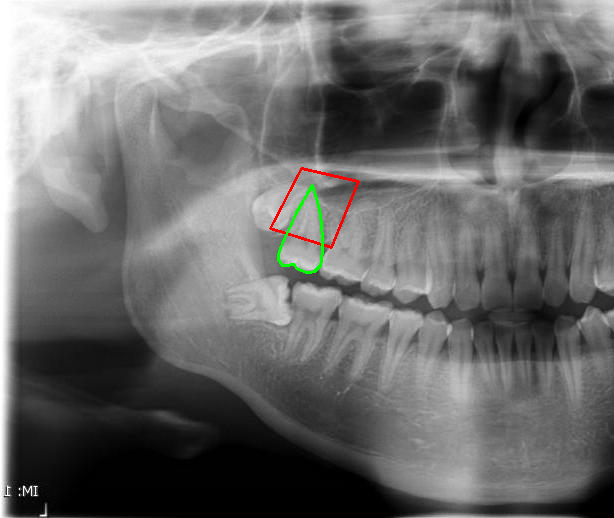

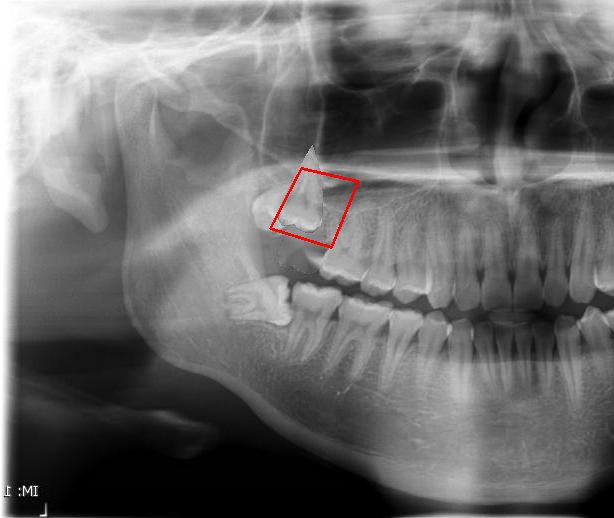

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


image_with_polygon = image.copy()

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -40  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


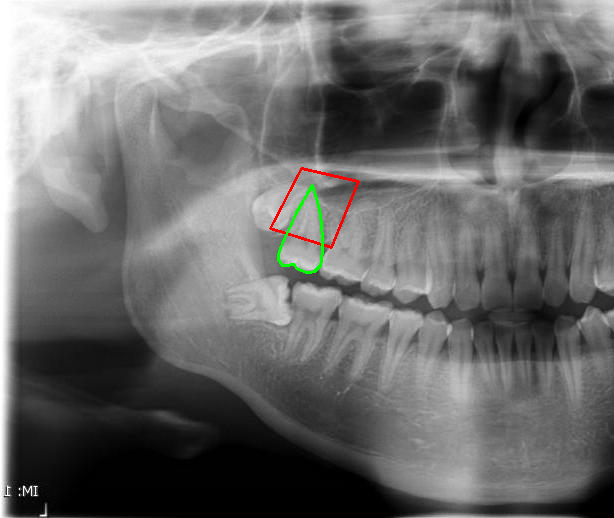

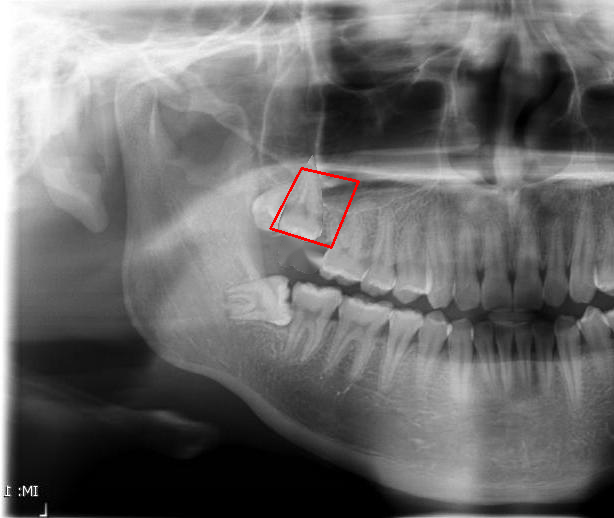

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


image_with_polygon = image.copy()

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -30  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


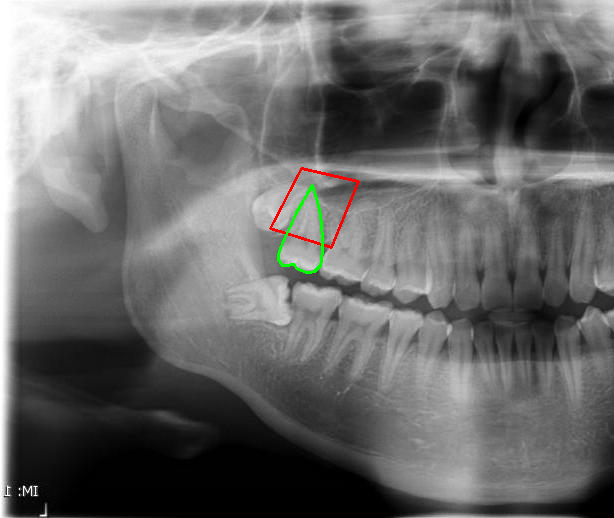

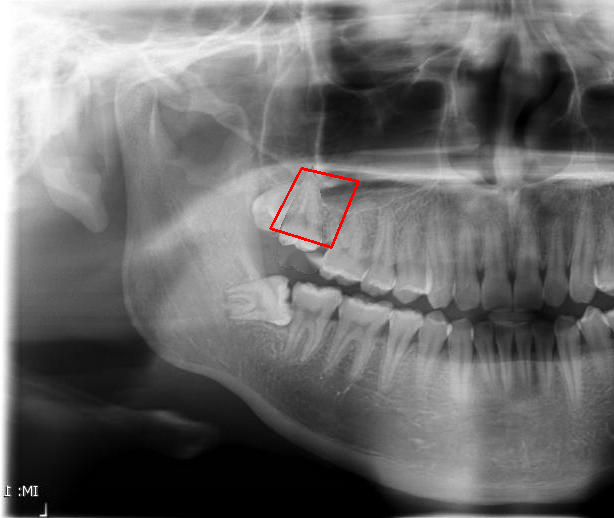

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


image_with_polygon = image.copy()

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -20  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


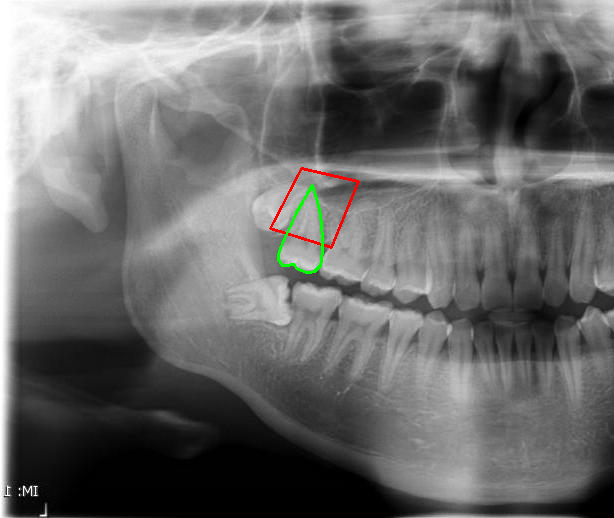

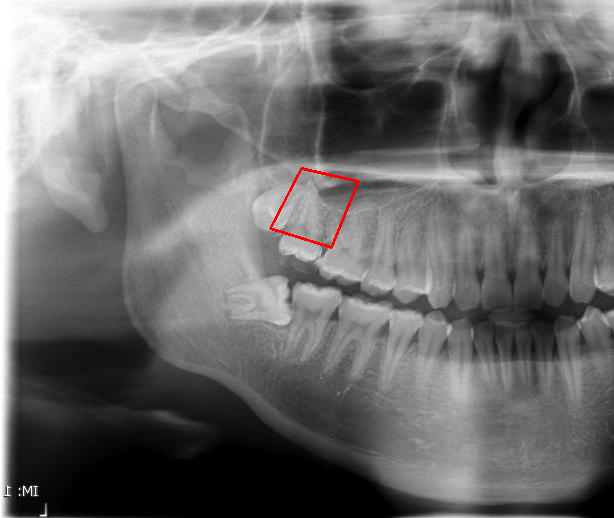

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


image_with_polygon = image.copy()

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -10  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


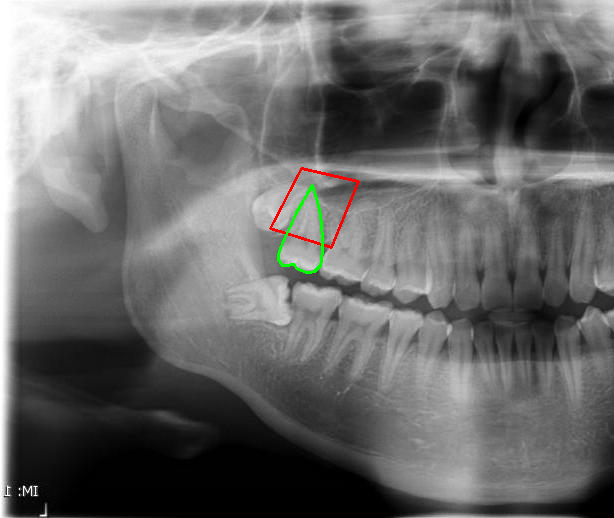

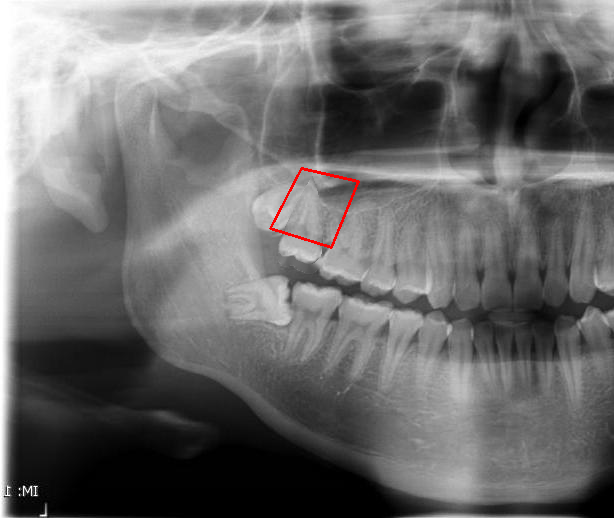

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)


image_with_polygon = image.copy()

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)
# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)



# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -9  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(0, 0, 255), thickness=2)

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


In [ ]:
range(-40, 11, 10)

range(-40, 11, 10)

In [ ]:
# prompt: range(-40, 11, 10) มีเลขอะไรบ้าง

print(list(range(-40, 11, 5)))

[-40, -35, -30, -25, -20, -15, -10, -5, 0, 5, 10]


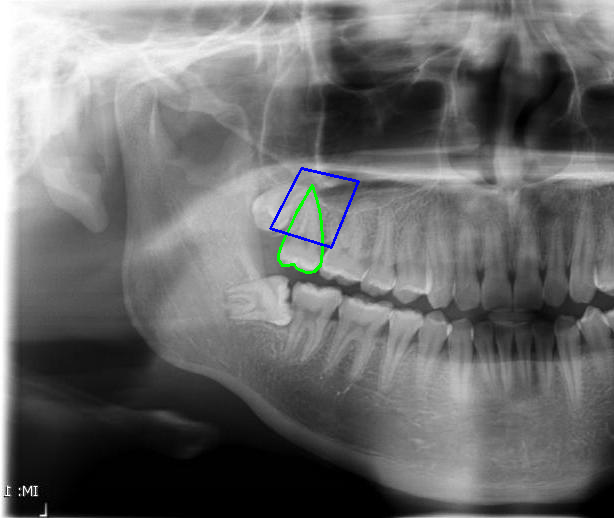

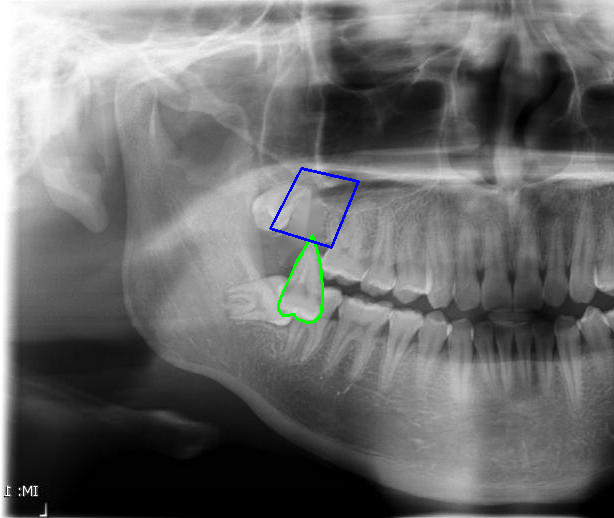

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)

# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
image_with_polygon = image.copy()
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(255, 0, 0), thickness=2)

# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 50  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(255, 0, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


In [ ]:
# import cv2
# import numpy as np
# import pandas as pd
# from google.colab.patches import cv2_imshow

# # โหลดภาพต้นฉบับ
# image_path = aa['Path_Name'][0]  # เส้นทางไฟล์ภาพ
# image = cv2.imread(image_path)
# name = "Tooth_Segmentation"  # ตัวอย่างชื่อ
# segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
# segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# # แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
# points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# # แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
# points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)

# # วาด Polygon แสดงตำแหน่งฟันเดิมและจุดอื่นบนภาพ
# image_with_polygon = image.copy()
# cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)
# cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(255, 0, 0), thickness=2)

# # แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
# cv2_imshow(image_with_polygon)

# # สร้าง Mask สำหรับฟัน
# mask = np.zeros(image.shape[:2], dtype=np.uint8)
# cv2.fillPoly(mask, [points_original], 255)

# # แยกเฉพาะตัวฟันจากภาพ
# tooth = cv2.bitwise_and(image, image, mask=mask)

# # กำหนด Bounding Box ของฟัน
# x, y, w, h = cv2.boundingRect(points_original)
# bounding_box = [x, y, w, h]

# # กำหนด scale factor สำหรับการเลื่อน
# scale_factor = 0.1  # สัดส่วนการเลื่อน: 10% ของความสูงของฟัน
# dy = int(h * scale_factor)  # ย้ายฟันลงล่าง 10% ของความสูงของ Bounding Box

# # สร้างเมทริกซ์สำหรับ Translation
# translation_matrix = np.float32([[1, 0, 0], [0, 1, dy]])

# # ย้ายภาพฟัน
# moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# # สร้าง Mask สำหรับฟันที่ย้ายไป
# moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# # สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
# inverse_mask = cv2.bitwise_not(mask)

# # ลบตัวฟันเดิมออกจากภาพต้นฉบับ
# image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# # ใช้ Inpainting เติมช่องว่าง
# image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# # รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
# final_image = image_inpaint.copy()
# final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# # วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
# moved_points = points_original + [0, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
# cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)
# cv2.polylines(final_image, [points_other], isClosed=True, color=(255, 0, 0), thickness=2)

# # แสดงผลลัพธ์
# cv2_imshow(final_image)

# # # สร้าง DataFrame เพื่อเก็บข้อมูล
# # data = {
# #     'name': [name, name],
# #     'path': [image_path, image_path],
# #     'box': [bounding_box, bounding_box],  # เก็บ Bounding Box
# #     'points_before': [points_original.tolist(), points_other.tolist()],
# #     'points_after': [moved_points.tolist(), points_other.tolist()]
# # }

# # df = pd.DataFrame(data)
# # print(df)

# # บันทึก DataFrame ถ้าต้องการ
# # df.to_csv("segmentation_data.csv", index=False)


# ได้

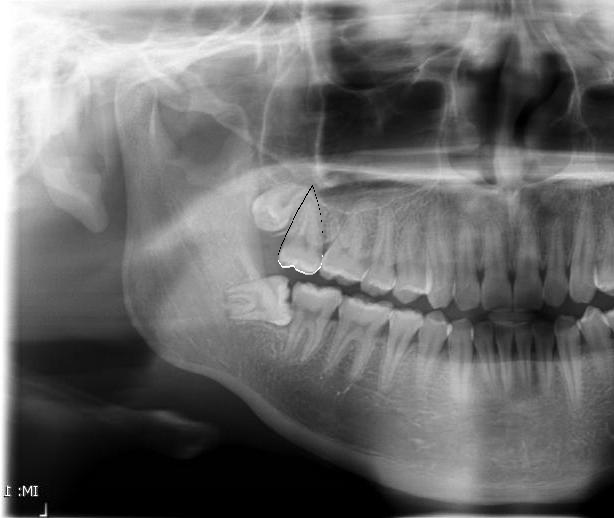

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation = aa['segmentation'][0][0]

points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask ว่างเปล่า
mask = np.zeros(image.shape[:2], dtype=np.uint8)

# วาด Polygon ลงบน Mask
cv2.fillPoly(mask, [points], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 2  # ย้ายไปทางขวา 50 px และลง 30 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# ลบตัวฟันเดิมจากภาพต้นฉบับ (Mask Inverse)
inverse_mask = cv2.bitwise_not(mask)
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# รวมฟันที่ย้ายตำแหน่งกับภาพต้นฉบับ
final_image = cv2.add(image_without_tooth, moved_tooth)

# แสดงผลภาพที่รวมแล้ว
cv2_imshow(final_image)


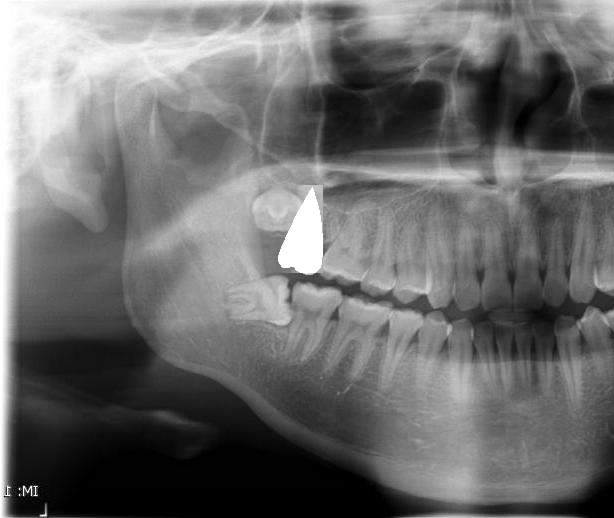

True

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 2  # ย้ายฟันลงล่าง 2 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ (Mask Inverse)
inverse_mask = cv2.bitwise_not(mask)
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# เติมพื้นที่ว่างด้วยการสะท้อน
# กำหนด Bounding Box ของฟันที่เลื่อน
x, y, w, h = cv2.boundingRect(points)

# เลือกพื้นที่ข้างเคียงเพื่อสะท้อน
region_to_reflect = image[y:y+h, x-w:x] if x-w >= 0 else image[y:y+h, x+w:x+2*w]  # ถ้า x-w < 0 เลือกสะท้อนด้านขวาแทน
reflected_region = cv2.flip(region_to_reflect, 1)  # สะท้อนแนวนอน

# ตรวจสอบขนาดของพื้นที่สะท้อนเพื่อให้ตรงกับพื้นที่ว่าง
reflected_region_resized = cv2.resize(reflected_region, (w, h))

# เติมภาพสะท้อนในพื้นที่ว่าง
image_without_tooth[y:y+h, x:x+w] = reflected_region_resized

# รวมฟันที่เลื่อนไปกับภาพต้นฉบับ
final_image = cv2.add(image_without_tooth, moved_tooth)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
cv2.imwrite("final_image_with_reflection_fill.jpg", final_image)


# ลอง

In [ ]:
aa

,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,...,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,1,1,1,"[[312.75, 185.1, 316.5, 198.5, 319.7, 209.7, 3...",2352.0,"[278.41, 185.1, 44.09, 87.6]",0,{'occluded': False},1,Upper Second Molar,...,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipS333.jpg,1,Male,19.090893,19.0,0.999866,Male,1.0
1,2,1,2,"[[331.9, 247.8, 270.4, 228.3, 301.7, 168.0, 35...",4230.0,"[270.4, 168.0, 88.1, 79.8]",0,{'occluded': False},2,Alveolar bone,...,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipS333.jpg,1,Male,19.090893,19.0,0.999866,Male,1.0


In [ ]:
import cv2
import numpy as np
import pandas as pd
from google.colab.patches import cv2_imshow

# # โหลดข้อมูลตาราง
# data = pd.DataFrame({
#     'segmentation': [[[312.75, 185.1, 316.5, 198.5, 319.7, 209.7, 316.5, 185.1]]],  # ตัวอย่างข้อมูล segmentation
#     'file_name': ['FlipS333.jpg']
# })

# โหลดภาพต้นฉบับจาก file_name
image_path = aa['file_name'][0]  # อ้างอิง path ของไฟล์ที่ถูกต้อง
image = cv2.imread(image_path)

# # ตรวจสอบว่าโหลดภาพสำเร็จหรือไม่
# if image is None:
#     raise ValueError("ไม่สามารถโหลดภาพได้ กรุณาตรวจสอบเส้นทางของไฟล์")

# ดึงข้อมูล segmentation
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 20  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ (Mask Inverse)
inverse_mask = cv2.bitwise_not(mask)
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# เติมพื้นที่ว่างด้วยการสะท้อน
# กำหนด Bounding Box ของฟันที่เลื่อน
x, y, w, h = cv2.boundingRect(points)

# เลือกพื้นที่ข้างเคียงเพื่อสะท้อน
if x - w >= 0:
    region_to_reflect = image[y:y+h, x-w:x]  # เลือกพื้นที่ทางซ้ายมือ
else:
    region_to_reflect = image[y:y+h, x+w:x+2*w]  # เลือกพื้นที่ทางขวามือในกรณีที่ซ้ายมือไม่เพียงพอ

# สะท้อนแนวนอน
reflected_region = cv2.flip(region_to_reflect, 1)

# ตรวจสอบขนาดของพื้นที่สะท้อนเพื่อให้ตรงกับพื้นที่ว่าง
reflected_region_resized = cv2.resize(reflected_region, (w, h))

# เติมภาพสะท้อนในพื้นที่ว่าง
image_without_tooth[y:y+h, x:x+w] = reflected_region_resized

# รวมฟันที่เลื่อนไปกับภาพต้นฉบับ
final_image = cv2.add(image_without_tooth, moved_tooth)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# # บันทึกผลลัพธ์
# cv2.imwrite("/mnt/data/final_image_with_reflection_fill.jpg", final_image)


AttributeError: 'NoneType' object has no attribute 'shape'

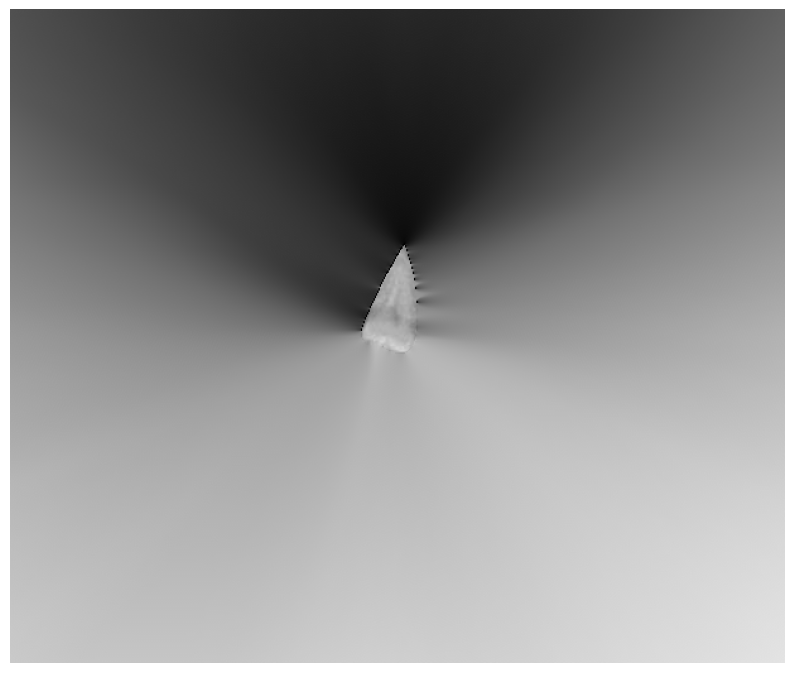

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# โหลดภาพต้นฉบับจากไฟล์ที่อัปโหลด
# image_path = '/mnt/data/image.png'
image = cv2.imread(aa['Path_Name'][0])

# ตรวจสอบว่าโหลดภาพสำเร็จหรือไม่
if image is None:
    print("ไม่สามารถโหลดภาพได้ กรุณาตรวจสอบที่อยู่ไฟล์")
else:
    # สร้าง Mask ว่างเปล่า
    mask = np.zeros(image.shape[:2], dtype=np.uint8)

    # จำลองการวาด Polygon (ควรจะใช้ข้อมูลที่กำหนดไว้)
    points = np.array(aa['segmentation'][0][0], dtype=np.int32).reshape((-1, 2))
    cv2.fillPoly(mask, [points], 255)

    # แยกเฉพาะตัวฟันจากภาพ
    tooth = cv2.bitwise_and(image, image, mask=mask)

    # กำหนดระยะการย้ายตำแหน่ง (dx, dy)
    dx, dy = 0, 2

    # สร้างเมทริกซ์สำหรับ Translation
    translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

    # ย้ายภาพฟัน
    moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

    # ลบตัวฟันเดิมจากภาพต้นฉบับ (Mask Inverse)
    inverse_mask = cv2.bitwise_not(mask)
    image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

    # รวมฟันที่ย้ายตำแหน่งกับภาพต้นฉบับ
    final_image = cv2.add(image_without_tooth, moved_tooth)

    # เติมช่องว่างที่เกิดจากการเลื่อนตำแหน่งด้วยการสะท้อนขอบ
    final_image_filled = cv2.inpaint(final_image, inverse_mask, 3, cv2.INPAINT_TELEA)

    # แสดงผลภาพที่รวมแล้ว
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(final_image_filled, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()


# ลอง 2

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)
points

array([[312, 185],
       [316, 198],
       [319, 209],
       [321, 223],
       [322, 239],
       [322, 249],
       [321, 260],
       [320, 265],
       [317, 268],
       [314, 271],
       [310, 272],
       [306, 272],
       [301, 270],
       [296, 268],
       [294, 264],
       [292, 264],
       [287, 265],
       [282, 265],
       [278, 259],
       [278, 254],
       [281, 245],
       [285, 236],
       [290, 226],
       [296, 212],
       [302, 202],
       [307, 193]], dtype=int32)

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
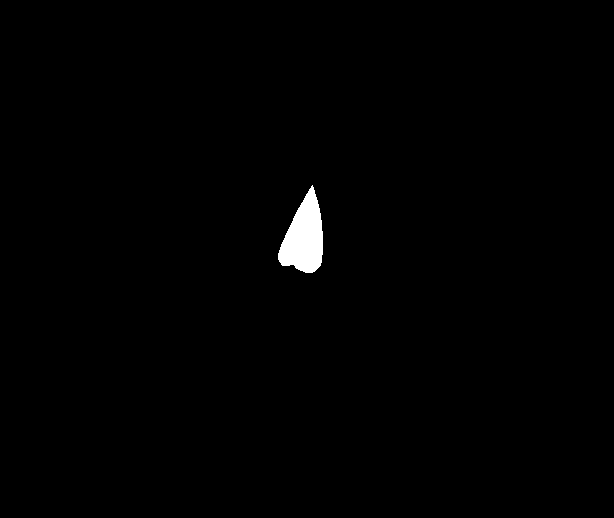

In [ ]:
# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)


array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)
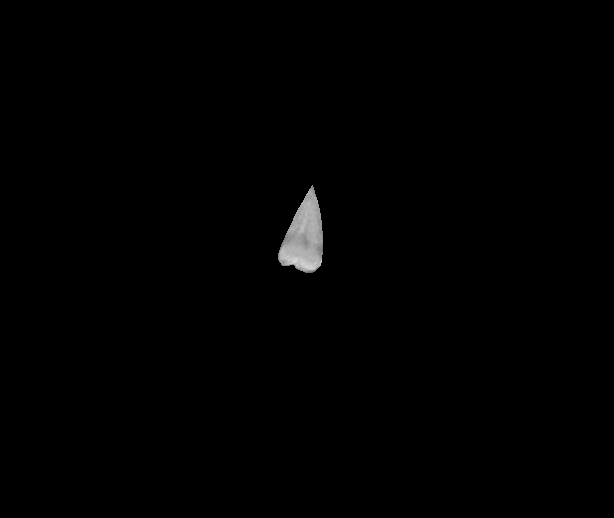

In [ ]:
# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)
tooth

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)
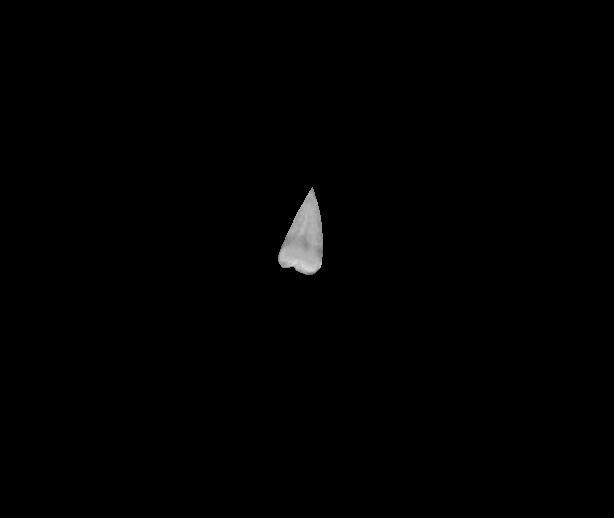

In [ ]:
# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 2  # ย้ายฟันลงล่าง 2 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))
moved_tooth

array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)
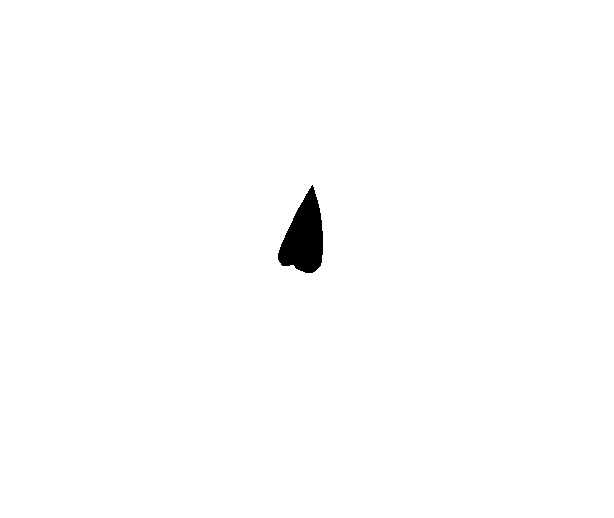

In [ ]:
# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask) #add
inverse_mask

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [219, 219, 219]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       ...,

       [[251, 251, 251],
        [240, 240, 240],
        [223, 223, 223],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[251, 251, 251],
        [242, 242, 242],
        [229, 229, 229],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[253, 253, 253],
        [247, 247, 247],
        [237, 237, 237],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]], dtype=uint8)
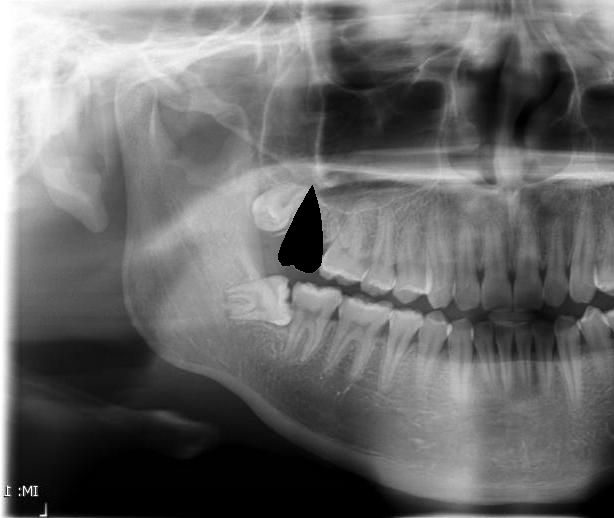

In [ ]:
# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)
image_without_tooth

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [219, 219, 219]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       ...,

       [[251, 251, 251],
        [240, 240, 240],
        [223, 223, 223],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[251, 251, 251],
        [242, 242, 242],
        [229, 229, 229],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[253, 253, 253],
        [247, 247, 247],
        [237, 237, 237],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]], dtype=uint8)
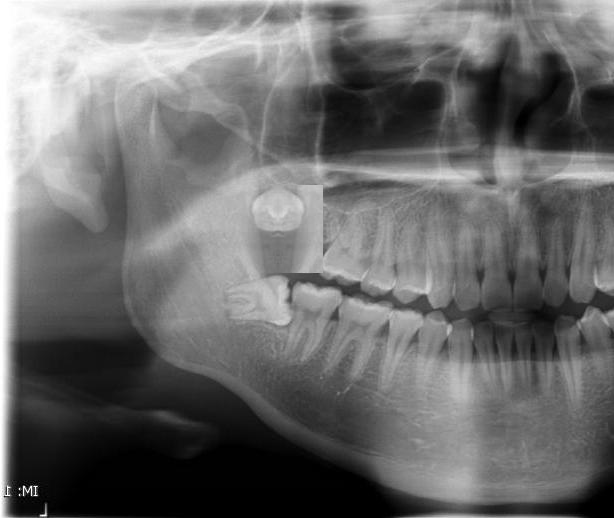

In [ ]:
# เติมพื้นที่ว่างด้วยการสะท้อน
# กำหนด Bounding Box ของฟันที่เลื่อน
x, y, w, h = cv2.boundingRect(points)

# เลือกพื้นที่ข้างเคียงเพื่อสะท้อน
if x - w >= 0:
    region_to_reflect = image[y:y+h, max(0, x-w):x]  # พื้นที่ด้านซ้ายของฟัน
else:
    region_to_reflect = image[y:y+h, x+w:x+2*w]  # พื้นที่ด้านขวาของฟัน ถ้าไม่สามารถเลือกด้านซ้ายได้
reflected_region = cv2.flip(region_to_reflect, 1)  # สะท้อนแนวนอน

# ตรวจสอบขนาดของพื้นที่สะท้อนเพื่อให้ตรงกับพื้นที่ว่าง
reflected_region_resized = cv2.resize(reflected_region, (w, h))

# เติมภาพสะท้อนในพื้นที่ว่างเดิม
image_without_tooth[y:y+h, x:x+w] = reflected_region_resized
image_without_tooth

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [219, 219, 219]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       ...,

       [[251, 251, 251],
        [240, 240, 240],
        [223, 223, 223],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[251, 251, 251],
        [242, 242, 242],
        [229, 229, 229],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[253, 253, 253],
        [247, 247, 247],
        [237, 237, 237],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]], dtype=uint8)
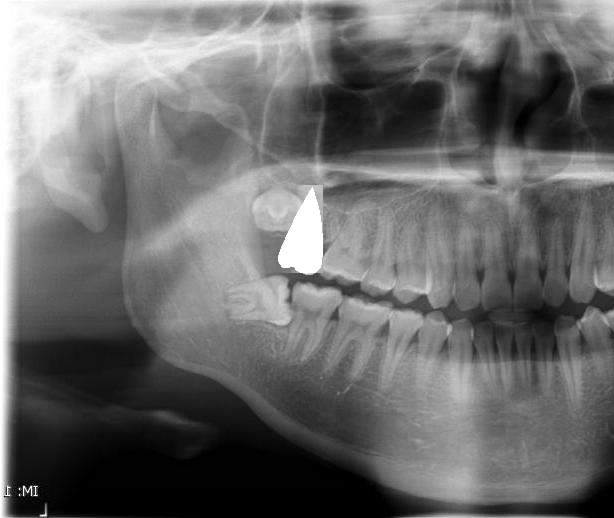

In [ ]:
final_image = cv2.add(image_without_tooth, moved_tooth)
final_image

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [219, 219, 219]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       ...,

       [[251, 251, 251],
        [240, 240, 240],
        [223, 223, 223],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[251, 251, 251],
        [242, 242, 242],
        [229, 229, 229],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[253, 253, 253],
        [247, 247, 247],
        [237, 237, 237],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]], dtype=uint8)
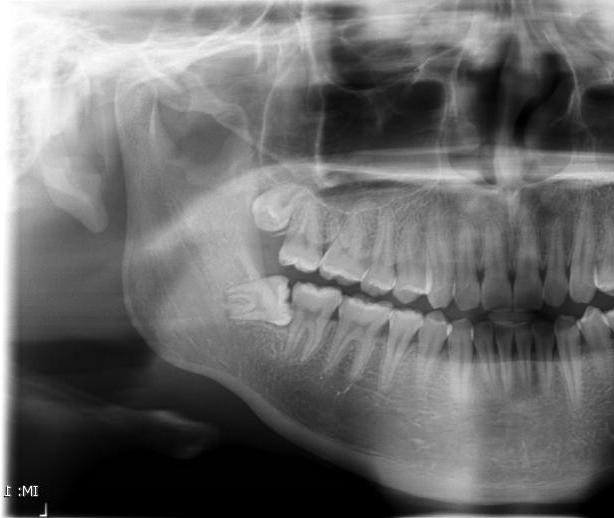

In [ ]:
image

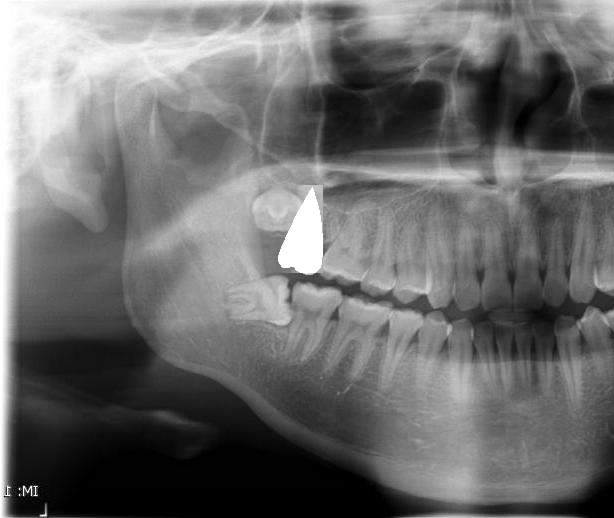

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 2  # ย้ายฟันลงล่าง 2 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))


# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask) #add
# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# เติมพื้นที่ว่างด้วยการสะท้อน
# กำหนด Bounding Box ของฟันที่เลื่อน
x, y, w, h = cv2.boundingRect(points)

# เลือกพื้นที่ข้างเคียงเพื่อสะท้อน
if x - w >= 0:
    region_to_reflect = image[y:y+h, max(0, x-w):x]  # พื้นที่ด้านซ้ายของฟัน
else:
    region_to_reflect = image[y:y+h, x+w:x+2*w]  # พื้นที่ด้านขวาของฟัน ถ้าไม่สามารถเลือกด้านซ้ายได้
reflected_region = cv2.flip(region_to_reflect, 1)  # สะท้อนแนวนอน

# ตรวจสอบขนาดของพื้นที่สะท้อนเพื่อให้ตรงกับพื้นที่ว่าง
reflected_region_resized = cv2.resize(reflected_region, (w, h))

# เติมภาพสะท้อนในพื้นที่ว่างเดิม
image_without_tooth[y:y+h, x:x+w] = reflected_region_resized

# รวมฟันที่เลื่อนไปกับภาพต้นฉบับ
final_image = cv2.add(image_without_tooth, moved_tooth)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# # บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_reflection_fill.jpg", final_image)


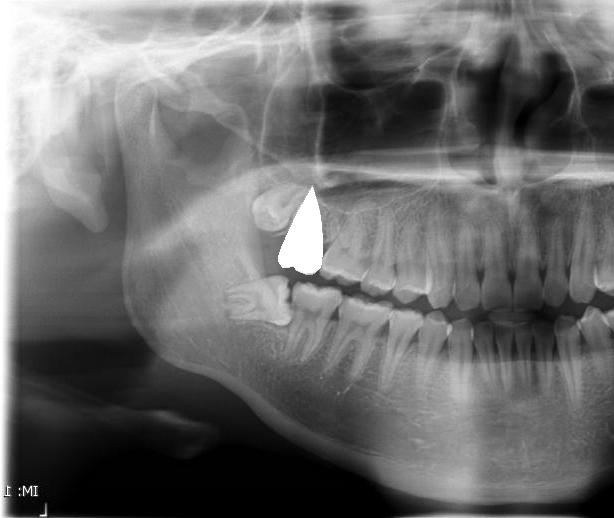

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 2  # ย้ายฟันลงล่าง 2 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# เติมพื้นที่ว่างด้วยการสะท้อน
# กำหนด Bounding Box ของฟันที่เลื่อน
x, y, w, h = cv2.boundingRect(points)

# เลือกพื้นที่ข้างเคียงเพื่อสะท้อน
if x - w >= 0:
    region_to_reflect = image[y:y+h, max(0, x-w):x]  # พื้นที่ด้านซ้ายของฟัน
else:
    region_to_reflect = image[y:y+h, x+w:x+2*w]  # พื้นที่ด้านขวาของฟัน ถ้าไม่สามารถเลือกด้านซ้ายได้
reflected_region = cv2.flip(region_to_reflect, 1)  # สะท้อนแนวนอน

# ตรวจสอบขนาดของพื้นที่สะท้อนเพื่อให้ตรงกับพื้นที่ว่าง
reflected_region_resized = cv2.resize(reflected_region, (w, h))

# เติมภาพสะท้อนในเฉพาะบริเวณที่เป็นสีดำ
for i in range(y, y + h):
    for j in range(x, x + w):
        if np.all(image_without_tooth[i, j] == 0):  # ตรวจสอบพิกเซลที่เป็นสีดำ (0, 0, 0)
            image_without_tooth[i, j] = reflected_region_resized[i - y, j - x]

# รวมฟันที่เลื่อนไปกับภาพต้นฉบับ
final_image = cv2.add(image_without_tooth, moved_tooth)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_reflection_fill.jpg", final_image)


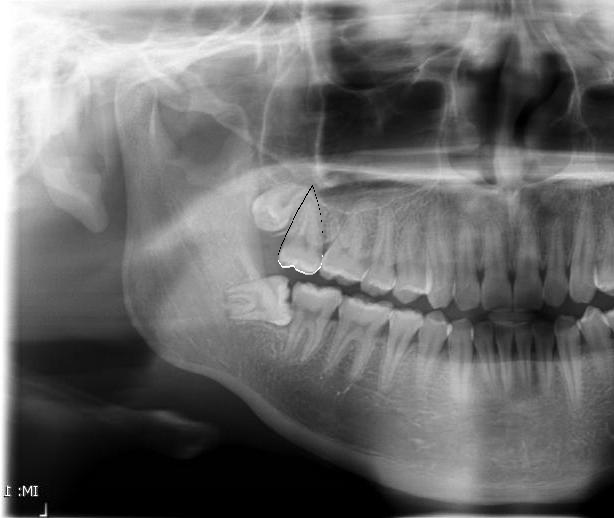

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 2  # ย้ายฟันลงล่าง 2 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# เติมพื้นที่ว่างด้วยการสะท้อน
# กำหนด Bounding Box ของฟันที่เลื่อน
x, y, w, h = cv2.boundingRect(points)

# เลือกพื้นที่ข้างเคียงเพื่อสะท้อน
if x - w >= 0:
    region_to_reflect = image[y:y+h, max(0, x-w):x]  # พื้นที่ด้านซ้ายของฟัน
else:
    region_to_reflect = image[y:y+h, x+w:x+2*w]  # พื้นที่ด้านขวาของฟัน ถ้าไม่สามารถเลือกด้านซ้ายได้
reflected_region = cv2.flip(region_to_reflect, 1)  # สะท้อนแนวนอน

# ตรวจสอบขนาดของพื้นที่สะท้อนเพื่อให้ตรงกับพื้นที่ว่าง
reflected_region_resized = cv2.resize(reflected_region, (w, h))

# เติมภาพสะท้อนในเฉพาะบริเวณที่เป็นสีดำ
for i in range(y, y + h):
    for j in range(x, x + w):
        if np.all(image_without_tooth[i, j] == 0):  # ตรวจสอบพิกเซลที่เป็นสีดำ (0, 0, 0)
            image_without_tooth[i, j] = reflected_region_resized[i - y, j - x]

# รวมฟันที่เลื่อนไปกับภาพต้นฉบับ โดยให้แน่ใจว่าผสมภาพอย่างถูกต้อง
combined_mask = cv2.bitwise_or(mask, mask)  # สร้าง mask ของฟันที่เลื่อนไป
final_image = cv2.bitwise_and(image_without_tooth, image_without_tooth, mask=cv2.bitwise_not(combined_mask))
final_image = cv2.add(final_image, moved_tooth)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_reflection_fill.jpg", final_image)


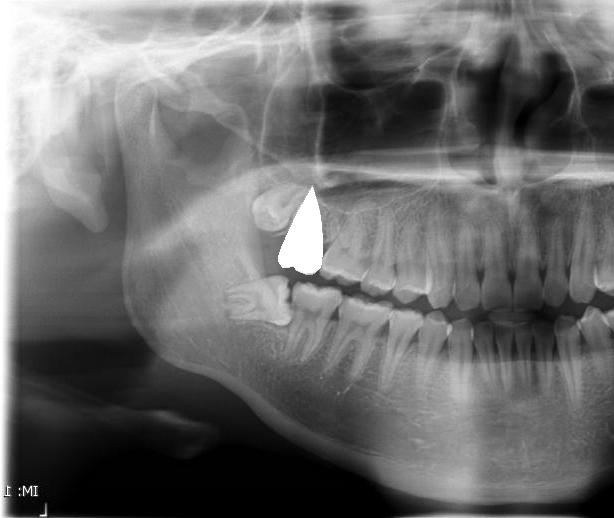

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 2  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# เติมพื้นที่ว่างด้วยการสะท้อน
# กำหนด Bounding Box ของฟันที่เลื่อน
x, y, w, h = cv2.boundingRect(points)

# เลือกพื้นที่ข้างเคียงเพื่อสะท้อน
if x - w >= 0:
    region_to_reflect = image[y:y+h, max(0, x-w):x]  # พื้นที่ด้านซ้ายของฟัน
else:
    region_to_reflect = image[y:y+h, x+w:x+2*w]  # พื้นที่ด้านขวาของฟัน ถ้าไม่สามารถเลือกด้านซ้ายได้
reflected_region = cv2.flip(region_to_reflect, 1)  # สะท้อนแนวนอน

# ตรวจสอบขนาดของพื้นที่สะท้อนเพื่อให้ตรงกับพื้นที่ว่าง
reflected_region_resized = cv2.resize(reflected_region, (w, h))

# เติมภาพสะท้อนในเฉพาะบริเวณที่เป็นสีดำ
for i in range(y, y + h):
    for j in range(x, x + w):
        if np.all(image_without_tooth[i, j] == 0):  # ตรวจสอบพิกเซลที่เป็นสีดำ (0, 0, 0)
            image_without_tooth[i, j] = reflected_region_resized[i - y, j - x]

# รวมฟันที่เลื่อนไปกับภาพต้นฉบับ
final_image = cv2.add(image_without_tooth, moved_tooth)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_reflection_fill.jpg", final_image)


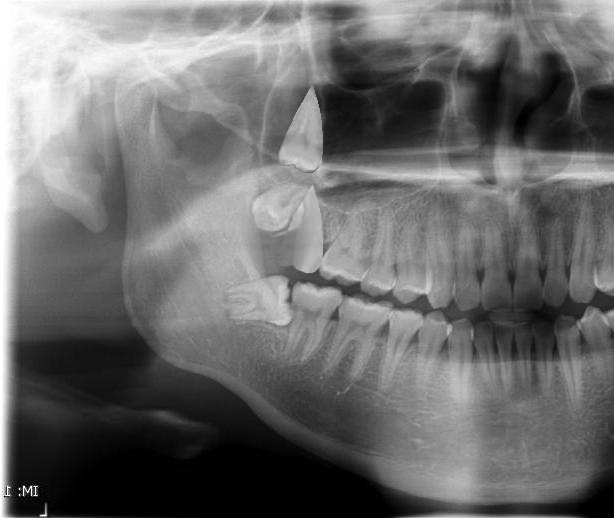

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -100  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# เติมพื้นที่ว่างด้วยการสะท้อน
# กำหนด Bounding Box ของฟันที่เลื่อน
x, y, w, h = cv2.boundingRect(points)

# เลือกพื้นที่ข้างเคียงเพื่อสะท้อน
if x - w >= 0:
    region_to_reflect = image[y:y+h, max(0, x-w):x]  # พื้นที่ด้านซ้ายของฟัน
else:
    region_to_reflect = image[y:y+h, x+w:x+2*w]  # พื้นที่ด้านขวาของฟัน ถ้าไม่สามารถเลือกด้านซ้ายได้
reflected_region = cv2.flip(region_to_reflect, 1)  # สะท้อนแนวนอน

# ตรวจสอบขนาดของพื้นที่สะท้อนเพื่อให้ตรงกับพื้นที่ว่าง
reflected_region_resized = cv2.resize(reflected_region, (w, h))

# เติมภาพสะท้อนในเฉพาะบริเวณที่เป็นสีดำ
for i in range(y, y + h):
    for j in range(x, x + w):
        if np.all(image_without_tooth[i, j] == 0):  # ตรวจสอบพิกเซลที่เป็นสีดำ (0, 0, 0)
            image_without_tooth[i, j] = reflected_region_resized[i - y, j - x]

# รวมฟันที่เลื่อนไปกับภาพต้นฉบับ
# สร้าง mask ที่จะใช้สำหรับการรวมภาพ
combined_mask = cv2.bitwise_not(moved_mask)
final_image = cv2.bitwise_and(image_without_tooth, image_without_tooth, mask=combined_mask)
final_image = cv2.add(final_image, moved_tooth)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_reflection_fill.jpg", final_image)


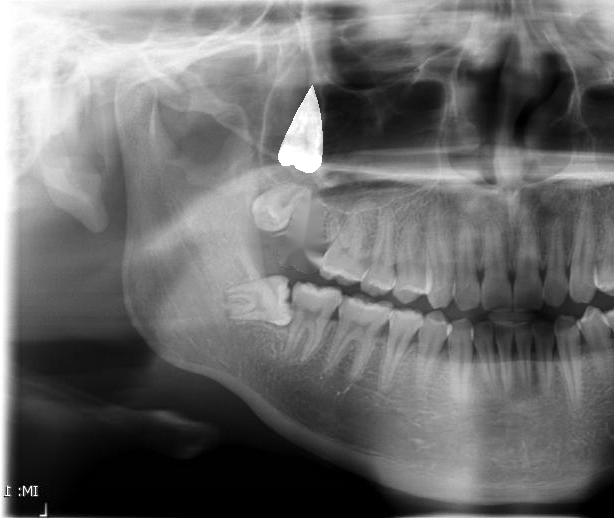

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -100  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = cv2.add(image_inpaint, moved_tooth)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint.jpg", final_image)


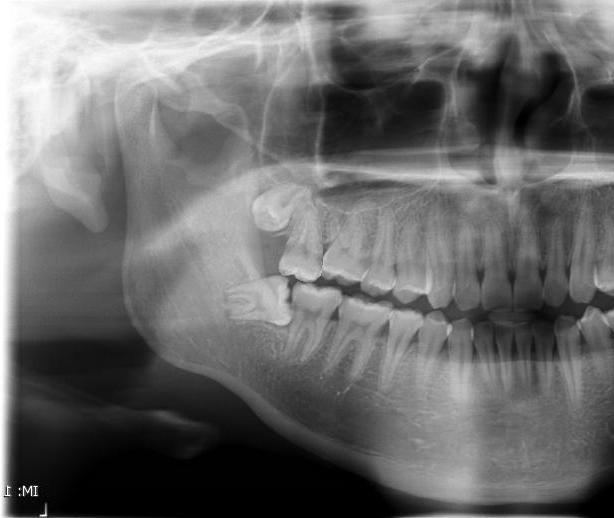

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 10  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
# ใช้ moved_mask เพื่อเป็น mask ในการระบุว่าต้องการวางภาพฟันที่ย้ายไปตรงไหน
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


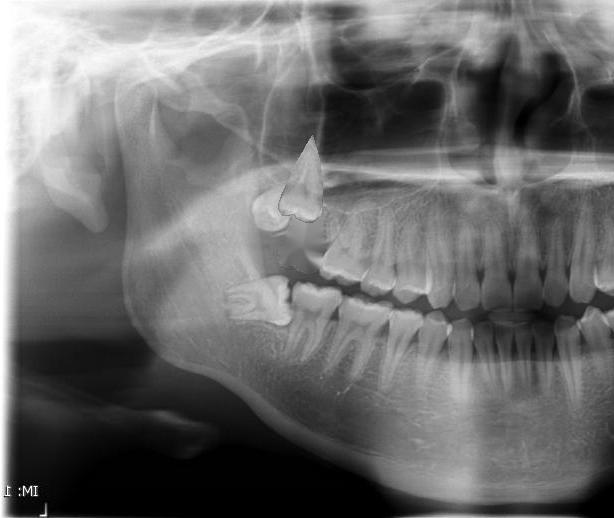

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -50  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
# ใช้ moved_mask เพื่อเป็น mask ในการระบุว่าต้องการวางภาพฟันที่ย้ายไปตรงไหน
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


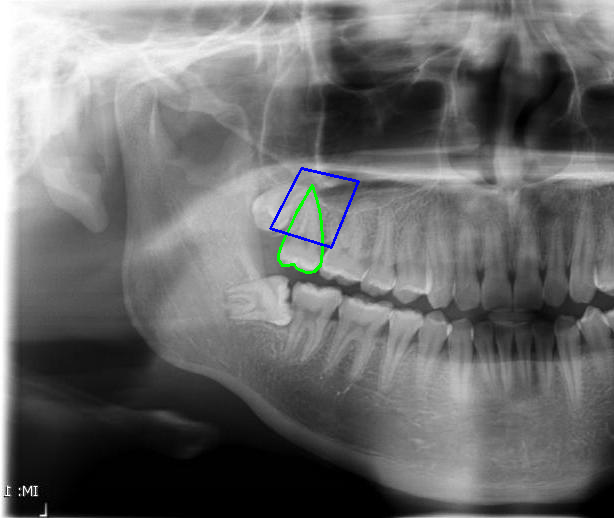

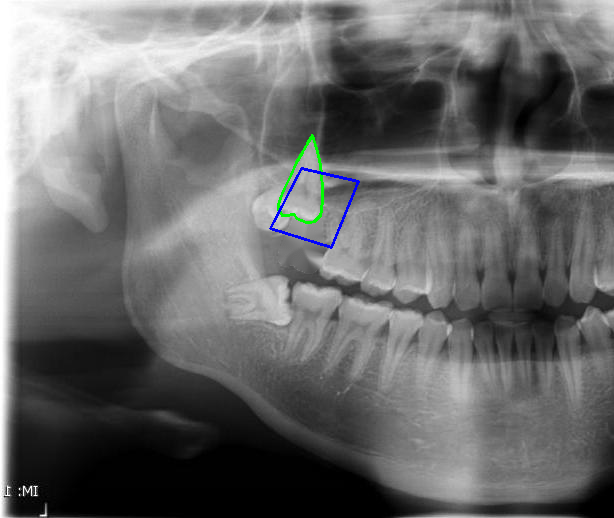

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)

# วาด Polygon แสดงตำแหน่งฟันเดิมบนภาพ
image_with_polygon = image.copy()
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพ
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(255, 0, 0), thickness=2)

# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, -50  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)

# วาด Polygon แสดงตำแหน่งจุดอื่นบนภาพสุดท้าย
cv2.polylines(final_image, [points_other], isClosed=True, color=(255, 0, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)


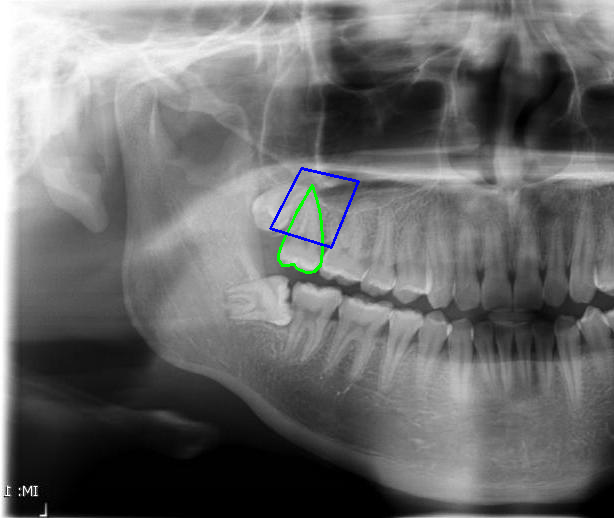

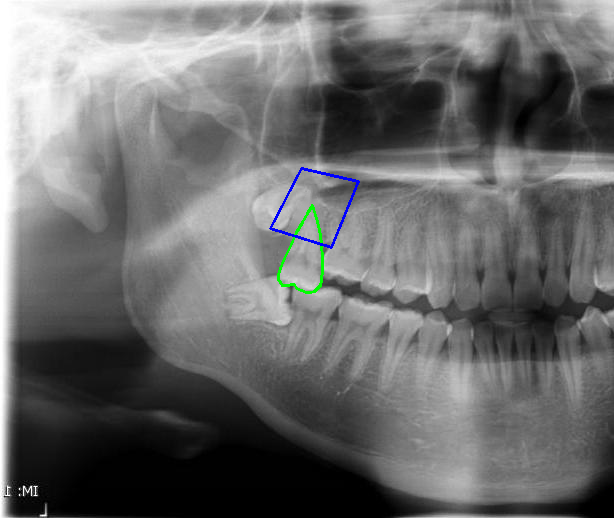

Segmentation Before Adjustment: {'original_points': [[312, 185], [316, 198], [319, 209], [321, 223], [322, 239], [322, 249], [321, 260], [320, 265], [317, 268], [314, 271], [310, 272], [306, 272], [301, 270], [296, 268], [294, 264], [292, 264], [287, 265], [282, 265], [278, 259], [278, 254], [281, 245], [285, 236], [290, 226], [296, 212], [302, 202], [307, 193]], 'other_points': [[331, 247], [270, 228], [301, 168], [358, 181]]}
Segmentation After Adjustment: {'moved_points': [[312, 205], [316, 218], [319, 229], [321, 243], [322, 259], [322, 269], [321, 280], [320, 285], [317, 288], [314, 291], [310, 292], [306, 292], [301, 290], [296, 288], [294, 284], [292, 284], [287, 285], [282, 285], [278, 279], [278, 274], [281, 265], [285, 256], [290, 246], [296, 232], [302, 222], [307, 213]], 'other_points': [[331, 247], [270, 228], [301, 168], [358, 181]]}
               stage                                    original_points  \
0  before_adjustment  [[312, 185], [316, 198], [319, 209], [321, 

In [ ]:
import cv2
import numpy as np
import pandas as pd
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)

# วาด Polygon แสดงตำแหน่งฟันเดิมและจุดอื่นบนภาพ
image_with_polygon = image.copy()
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(255, 0, 0), thickness=2)

# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 20  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# เก็บตำแหน่งของ segmentation ก่อนและหลังปรับ
# ตำแหน่งก่อนปรับ
segmentation_before_adjustment = {
    'original_points': points_original.tolist(),
    'other_points': points_other.tolist()
}

# ตำแหน่งหลังการย้ายฟัน
moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
segmentation_after_adjustment = {
    'moved_points': moved_points.tolist(),
    'other_points': points_other.tolist()
}

# วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)
cv2.polylines(final_image, [points_other], isClosed=True, color=(255, 0, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# บันทึกผลลัพธ์
# cv2.imwrite("final_image_with_inpaint_and_tooth.jpg", final_image)

# แสดงตำแหน่ง segmentation ก่อนและหลังการปรับ
print("Segmentation Before Adjustment:", segmentation_before_adjustment)
print("Segmentation After Adjustment:", segmentation_after_adjustment)

# หากต้องการเก็บตำแหน่งใน DataFrame
data = {
    'stage': ['before_adjustment', 'after_adjustment'],
    'original_points': [segmentation_before_adjustment['original_points'], segmentation_after_adjustment['moved_points']],
    'other_points': [segmentation_before_adjustment['other_points'], segmentation_after_adjustment['other_points']]
}

df = pd.DataFrame(data)
print(df)


In [ ]:
aa

,id_x,image_id,category_id,segmentation,area,bbox,iscrowd,attributes,id_y,name,...,Folder_name,Path_Name,Filename,Gender_Class,Gender_Predict,Age_predict,Age_predict_int,Gender_predict,Gender_predict_str,Gender_predict_int
0,1,1,1,"[[312.75, 185.1, 316.5, 198.5, 319.7, 209.7, 3...",2352.0,"[278.41, 185.1, 44.09, 87.6]",0,{'occluded': False},1,Upper Second Molar,...,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipS333.jpg,1,Male,19.090893,19.0,0.999866,Male,1.0
1,2,1,2,"[[331.9, 247.8, 270.4, 228.3, 301.7, 168.0, 35...",4230.0,"[270.4, 168.0, 88.1, 79.8]",0,{'occluded': False},2,Alveolar bone,...,Lt,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,FlipS333.jpg,1,Male,19.090893,19.0,0.999866,Male,1.0


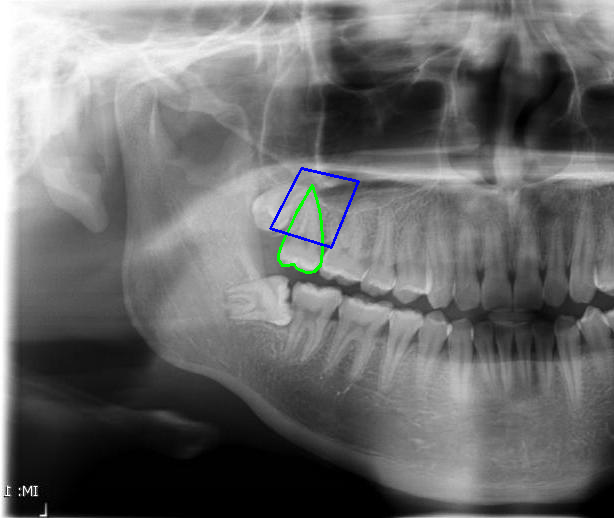

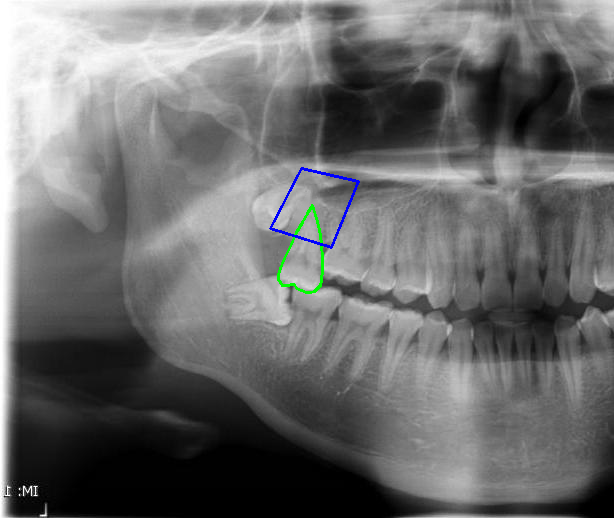

,name,Filename,path,box,points_before,points_after
0,0 Upper Second Molar 1 Alveolar bon...,0 FlipS333.jpg 1 FlipS333.jpg Name: File...,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,"[278, 185, 45, 88]","[[312, 185], [316, 198], [319, 209], [321, 223...","[[312, 205], [316, 218], [319, 229], [321, 243..."
1,0 Upper Second Molar 1 Alveolar bon...,0 FlipS333.jpg 1 FlipS333.jpg Name: File...,/content/gdrive/MyDrive/Tooth_Shap_GPT/Deep_to...,"[278, 185, 45, 88]","[[331, 247], [270, 228], [301, 168], [358, 181]]","[[331, 247], [270, 228], [301, 168], [358, 181]]"


In [ ]:
import cv2
import numpy as np
import pandas as pd
from google.colab.patches import cv2_imshow

# สมมุติว่าข้อมูลเหล่านี้ถูกเก็บไว้ใน aa
# โหลดภาพต้นฉบับ
image_path = aa['Path_Name'][0]  # เส้นทางไฟล์ภาพ
image = cv2.imread(image_path)
name = aa['name']  # ตัวอย่างชื่อ
Filename = aa['Filename']
segmentation_original = aa['segmentation'][0][0]  # Segmentation ของฟันเดิม
segmentation_other = aa['segmentation'][1][0]  # Segmentation ของจุดอื่น

# แปลง Segmentation ของฟันเดิมเป็น Array ของจุด
points_original = np.array(segmentation_original, dtype=np.int32).reshape(-1, 2)

# แปลง Segmentation ของจุดอื่นเป็น Array ของจุด
points_other = np.array(segmentation_other, dtype=np.int32).reshape(-1, 2)

# วาด Polygon แสดงตำแหน่งฟันเดิมและจุดอื่นบนภาพ
image_with_polygon = image.copy()
cv2.polylines(image_with_polygon, [points_original], isClosed=True, color=(0, 255, 0), thickness=2)
cv2.polylines(image_with_polygon, [points_other], isClosed=True, color=(255, 0, 0), thickness=2)

# แสดงผลภาพที่มี Polygon ของฟันเดิมและจุดอื่น
cv2_imshow(image_with_polygon)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points_original], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 20  # ย้ายฟันลงล่าง 20 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask สำหรับฟันที่ย้ายไป
moved_mask = cv2.warpAffine(mask, translation_matrix, (image.shape[1], image.shape[0]))

# สร้าง Mask Inverse สำหรับลบตัวฟันเดิม
inverse_mask = cv2.bitwise_not(mask)

# ลบตัวฟันเดิมออกจากภาพต้นฉบับ
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# ใช้ Inpainting เติมช่องว่าง
image_inpaint = cv2.inpaint(image_without_tooth, mask, 3, cv2.INPAINT_TELEA)

# รวมฟันที่เลื่อนไปกับภาพที่ถูกเติมช่องว่างด้วย Inpainting
final_image = image_inpaint.copy()
final_image[moved_mask == 255] = moved_tooth[moved_mask == 255]

# เก็บข้อมูล Bounding Box ของฟัน
x, y, w, h = cv2.boundingRect(points_original)
bounding_box = [x, y, w, h]

# เก็บตำแหน่งของ segmentation ก่อนและหลังปรับ
# ตำแหน่งก่อนปรับ
segmentation_before_adjustment = {
    'original_points': points_original.tolist(),
    'other_points': points_other.tolist()
}

# ตำแหน่งหลังการย้ายฟัน
moved_points = points_original + [dx, dy]  # ปรับพิกัดของจุดให้ตรงกับการย้าย
segmentation_after_adjustment = {
    'moved_points': moved_points.tolist(),
    'other_points': points_other.tolist()
}

# วาด Polygon แสดงตำแหน่งฟันที่ย้ายแล้วบนภาพสุดท้าย
cv2.polylines(final_image, [moved_points], isClosed=True, color=(0, 255, 0), thickness=2)
cv2.polylines(final_image, [points_other], isClosed=True, color=(255, 0, 0), thickness=2)

# แสดงผลลัพธ์
cv2_imshow(final_image)

# สร้าง DataFrame เพื่อเก็บข้อมูล
data = {
    'name': [name, name],
    'Filename':[Filename,Filename],
    'path': [image_path, image_path],
    'box': [bounding_box, bounding_box],  # เก็บ Bounding Box
    'points_before': [segmentation_before_adjustment['original_points'], segmentation_before_adjustment['other_points']],
    'points_after': [segmentation_after_adjustment['moved_points'], segmentation_after_adjustment['other_points']]
}

df = pd.DataFrame(data)
df

# บันทึก DataFrame ถ้าต้องการ
# df.to_csv("segmentation_data.csv", index=False)


In [ ]:
df

,stage,original_points,other_points
0,before_adjustment,"[[312, 185], [316, 198], [319, 209], [321, 223...","[[331, 247], [270, 228], [301, 168], [358, 181]]"
1,after_adjustment,"[[312, 205], [316, 218], [319, 229], [321, 243...","[[331, 247], [270, 228], [301, 168], [358, 181]]"


array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)
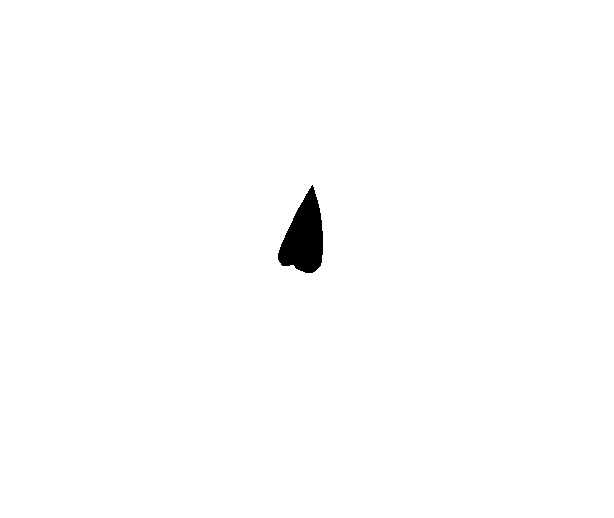

In [ ]:
inverse_mask

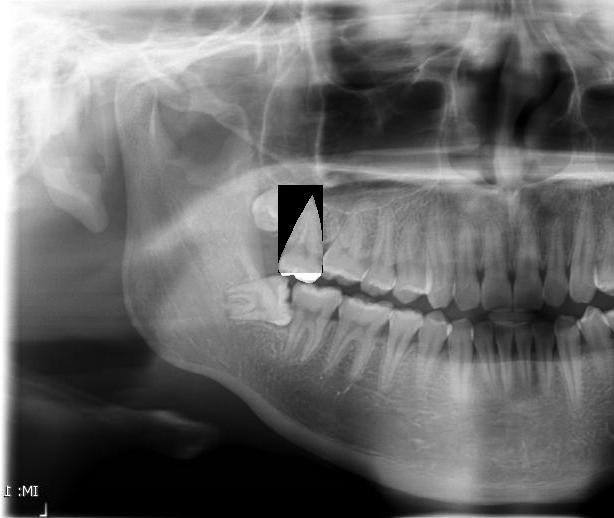

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
segmentation = aa['segmentation'][0][0]
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)
mask = np.zeros(image.shape[:2], dtype=np.uint8)

# วาด Polygon ลงบน Mask
cv2.fillPoly(mask, [points], 255)

# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)

# # แสดงผลภาพฟันที่แยกได้
# cv2_imshow(tooth)

# สร้าง Bounding Box ของฟัน
x, y, w, h = cv2.boundingRect(points)

# ครอบฟันที่ต้องการเลื่อน
tooth_region = tooth[y:y+h, x:x+w]

# เลื่อนฟันไปตำแหน่งใหม่
dx, dy = 0, 5  # ระยะการเลื่อน (ไปทางขวา 50 px)
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])
moved_tooth = cv2.warpAffine(tooth_region, translation_matrix, (image.shape[1], image.shape[0]))

# # เติมพื้นที่ว่างด้วยการสะท้อน
# region_to_reflect = image[y:y+h, x-w:x]  # พื้นที่ด้านซ้ายของฟัน
# reflected_region = cv2.flip(region_to_reflect, 1)  # สะท้อนแนวนอน

# # เติมภาพสะท้อนในพื้นที่ว่าง
# image[y:y+h, x:x+w] = reflected_region

# วางฟันที่เลื่อนไปในตำแหน่งใหม่
image[y:y+h, x+dx:x+w+dx] = moved_tooth[y:y+h, x+dx:x+w+dx]

# # แสดงผลลัพธ์
# cv2_imshow(image)

# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 10  # ย้ายไปทางขวา 50 px และลง 30 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# # แสดงผลภาพฟันที่ย้าย
# cv2_imshow(moved_tooth)

# ลบตัวฟันเดิมจากภาพต้นฉบับ (Mask Inverse)
inverse_mask = cv2.bitwise_not(mask)
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# รวมฟันที่ย้ายตำแหน่งกับภาพต้นฉบับ
final_image = cv2.add(image_without_tooth, moved_tooth)

# แสดงผลภาพที่รวมแล้ว
cv2_imshow(final_image)

# # บันทึกภาพผลลัพธ์
# cv2.imwrite("final_image.jpg", final_image)


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])

# Segmentation (ตำแหน่งของฟัน)
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# ตัดฟันออกจากภาพ
cropped_tooth = cv2.bitwise_and(image, image, mask=mask)

# สร้าง Bounding Box ของฟัน
x, y, w, h = cv2.boundingRect(points)

# ครอบฟันที่ต้องการเลื่อน
tooth_region = cropped_tooth[y:y+h, x:x+w]

# ลบฟันเดิมจากภาพต้นฉบับ
inverse_mask = cv2.bitwise_not(mask)
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# เลื่อนฟันไปตำแหน่งใหม่
dx, dy = 50, 0  # ระยะการเลื่อน (ไปทางขวา 50 px)
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])
moved_tooth = cv2.warpAffine(tooth_region, translation_matrix, (image.shape[1], image.shape[0]))

# เติมพื้นที่ว่างด้วยการสะท้อน
region_to_reflect = image[y:y+h, x-w:x]  # พื้นที่ด้านซ้ายของฟันเดิม
reflected_region = cv2.flip(region_to_reflect, 1)  # สะท้อนแนวนอน

# เติมภาพสะท้อนในพื้นที่ว่างเดิม
image_without_tooth[y:y+h, x:x+w] = reflected_region

# วางฟันที่เลื่อนไปในตำแหน่งใหม่
image_without_tooth[y:y+h, x+dx:x+w+dx] = moved_tooth

# แสดงผลลัพธ์
cv2_imshow(image_without_tooth)

# บันทึกภาพผลลัพธ์
cv2.imwrite("image_with_reflection_fill.jpg", image_without_tooth)


ValueError: could not broadcast input array from shape (518,614,3) into shape (88,45,3)

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [219, 219, 219]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       ...,

       [[251, 251, 251],
        [240, 240, 240],
        [223, 223, 223],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[251, 251, 251],
        [242, 242, 242],
        [229, 229, 229],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[253, 253, 253],
        [247, 247, 247],
        [237, 237, 237],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]], dtype=uint8)
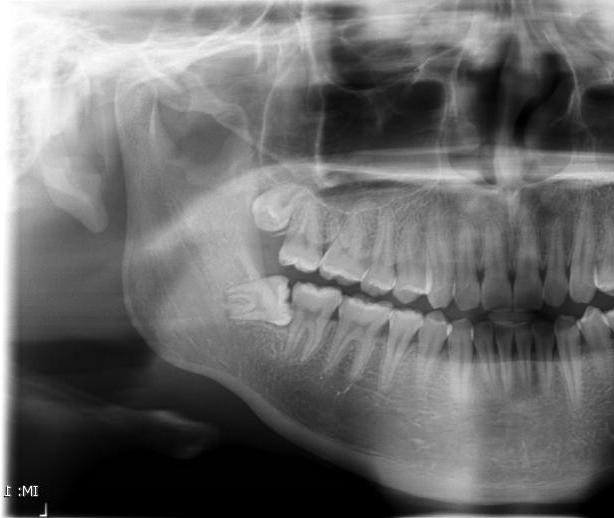

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
image

In [ ]:

# สร้าง Mask สำหรับฟัน (จาhttps://colab.research.google.com/drive/165iwyPM00SwukYU1wt9I3cIQAtbkyagj#scrollTo=try_2ndก segmentation หรือ bbox)
segmentation = aa['segmentation'][0][0]
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)
points

array([[312, 185],
       [316, 198],
       [319, 209],
       [321, 223],
       [322, 239],
       [322, 249],
       [321, 260],
       [320, 265],
       [317, 268],
       [314, 271],
       [310, 272],
       [306, 272],
       [301, 270],
       [296, 268],
       [294, 264],
       [292, 264],
       [287, 265],
       [282, 265],
       [278, 259],
       [278, 254],
       [281, 245],
       [285, 236],
       [290, 226],
       [296, 212],
       [302, 202],
       [307, 193]], dtype=int32)

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
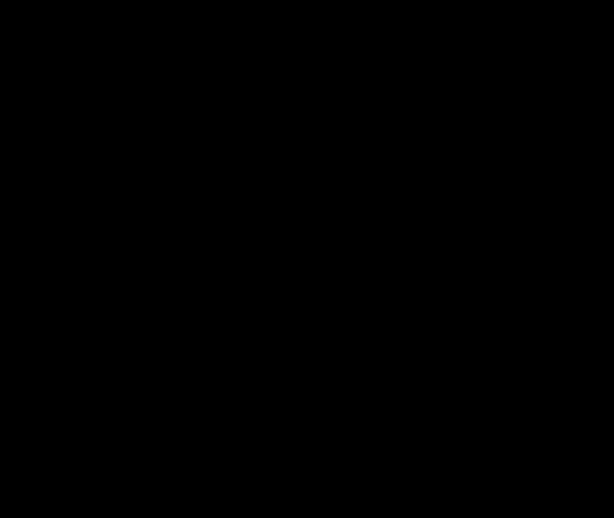

In [ ]:
# สร้าง Mask ว่างเปล่า
mask = np.zeros(image.shape[:2], dtype=np.uint8)
mask

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
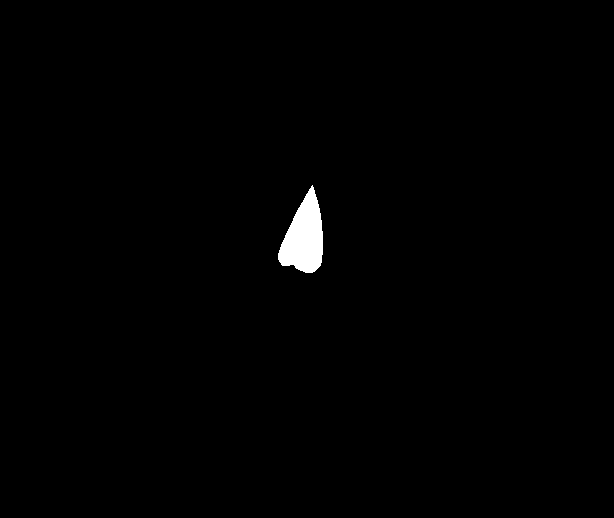

In [ ]:
# วาด Polygon ลงบน Mask
cv2.fillPoly(mask, [points], 255)

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)
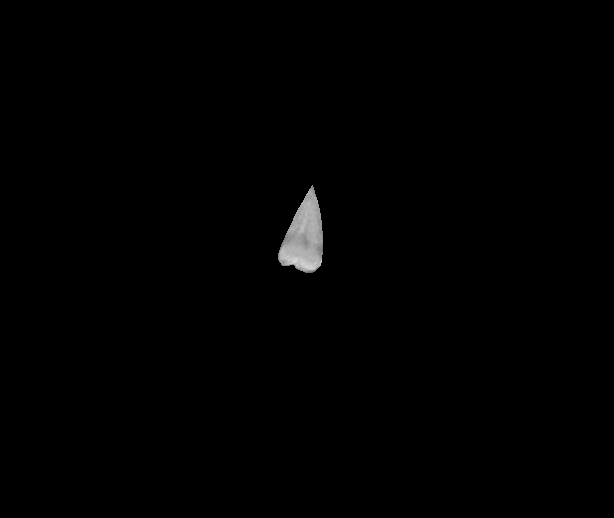

In [ ]:
# แยกเฉพาะตัวฟันจากภาพ
tooth = cv2.bitwise_and(image, image, mask=mask)
tooth

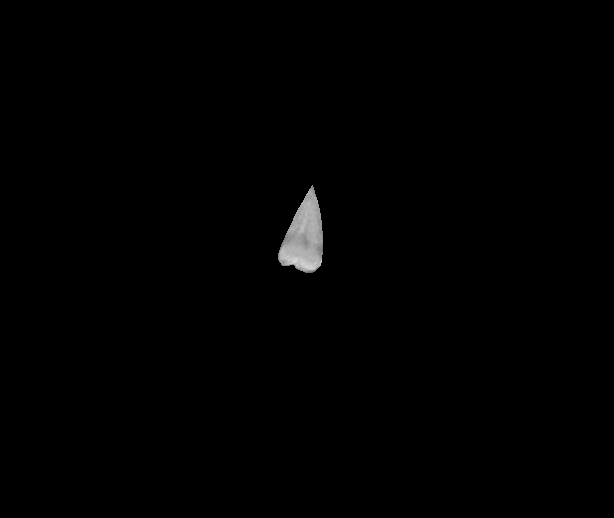

In [ ]:
# แสดงผลภาพฟันที่แยกได้
cv2_imshow(tooth)


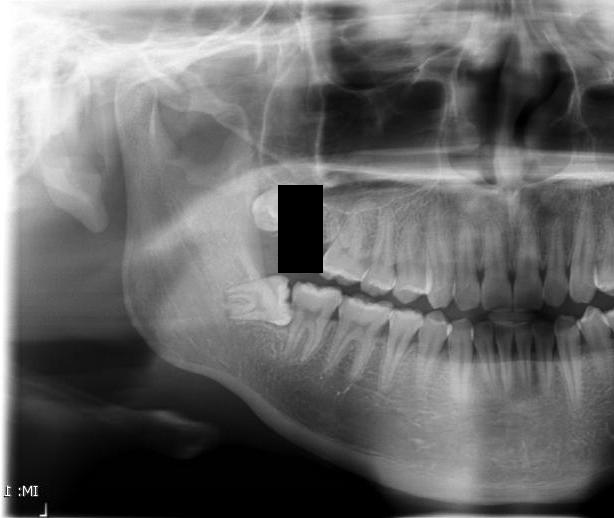

In [ ]:
# สร้าง Bounding Box ของฟัน
x, y, w, h = cv2.boundingRect(points)

# ครอบฟันที่ต้องการเลื่อน
tooth_region = tooth[y:y+h, x:x+w]

# เลื่อนฟันไปตำแหน่งใหม่
dx, dy = 0, 5  # ระยะการเลื่อน (ไปทางขวา 50 px)
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])
moved_tooth = cv2.warpAffine(tooth_region, translation_matrix, (image.shape[1], image.shape[0]))

# เติมพื้นที่ว่างด้วยการสะท้อน
region_to_reflect = image[y:y+h, x-w:x]  # พื้นที่ด้านซ้ายของฟัน
reflected_region = cv2.flip(region_to_reflect, 1)  # สะท้อนแนวนอน

# เติมภาพสะท้อนในพื้นที่ว่าง
image[y:y+h, x:x+w] = reflected_region

# วางฟันที่เลื่อนไปในตำแหน่งใหม่
image[y:y+h, x+dx:x+w+dx] = moved_tooth[y:y+h, x+dx:x+w+dx]

# แสดงผลลัพธ์
cv2_imshow(image)

# # บันทึกผลลัพธ์
# cv2.imwrite("image_with_moved_and_reflected_tooth.jpg", image)

In [ ]:
# import cv2
# import numpy as np
# from google.colab.patches import cv2_imshow

# # โหลดภาพต้นฉบับ
# image = cv2.imread(aa['Path_Name'][0])

# # สร้าง Mask สำหรับฟัน (จาhttps://colab.research.google.com/drive/165iwyPM00SwukYU1wt9I3cIQAtbkyagj#scrollTo=try_2ndก segmentation หรือ bbox)
# segmentation = aa['segmentation'][0][0]
# points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# # สร้าง Mask ว่างเปล่า
# mask = np.zeros(image.shape[:2], dtype=np.uint8)

# # วาด Polygon ลงบน Mask
# cv2.fillPoly(mask, [points], 255)

# # แยกเฉพาะตัวฟันจากภาพ
# tooth = cv2.bitwise_and(image, image, mask=mask)

# # แสดงผลภาพฟันที่แยกได้
# cv2_imshow(tooth)


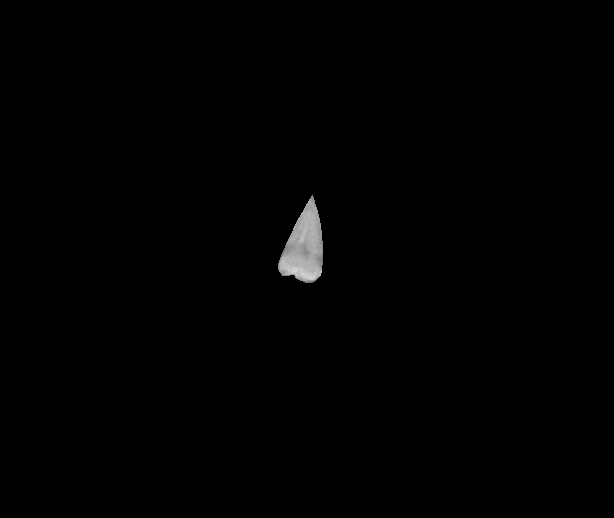

In [ ]:
# กำหนดระยะการย้ายตำแหน่ง (dx, dy)
dx, dy = 0, 10  # ย้ายไปทางขวา 50 px และลง 30 px

# สร้างเมทริกซ์สำหรับ Translation
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])

# ย้ายภาพฟัน
moved_tooth = cv2.warpAffine(tooth, translation_matrix, (image.shape[1], image.shape[0]))

# แสดงผลภาพฟันที่ย้าย
cv2_imshow(moved_tooth)


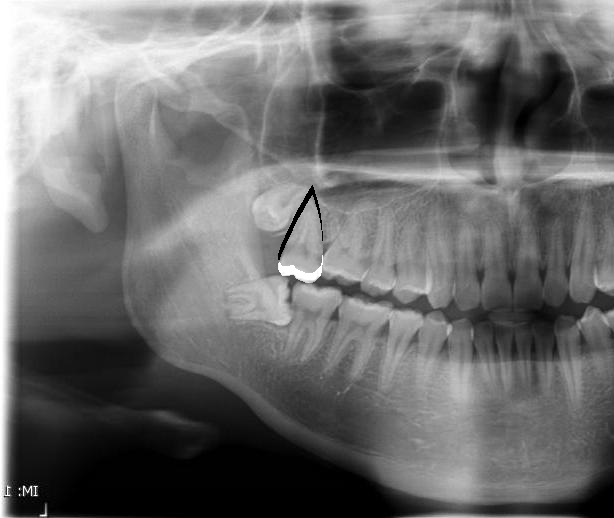

True

In [ ]:
# ลบตัวฟันเดิมจากภาพต้นฉบับ (Mask Inverse)
inverse_mask = cv2.bitwise_not(mask)
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# รวมฟันที่ย้ายตำแหน่งกับภาพต้นฉบับ
final_image = cv2.add(image_without_tooth, moved_tooth)

# แสดงผลภาพที่รวมแล้ว
cv2_imshow(final_image)

# บันทึกภาพผลลัพธ์
cv2.imwrite("final_image.jpg", final_image)


array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [219, 219, 219]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       ...,

       [[251, 251, 251],
        [240, 240, 240],
        [223, 223, 223],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[251, 251, 251],
        [242, 242, 242],
        [229, 229, 229],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[253, 253, 253],
        [247, 247, 247],
        [237, 237, 237],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]], dtype=uint8)
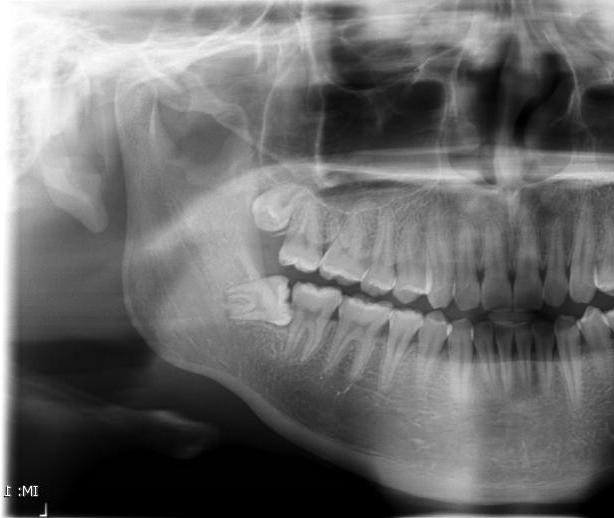

In [ ]:
# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
image

ฟฟฟฟ

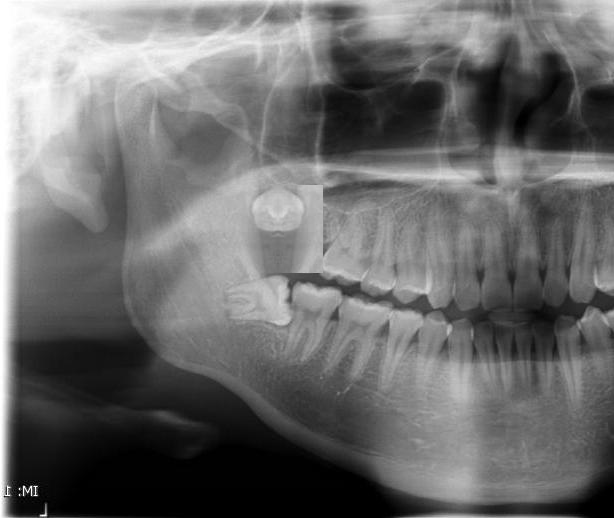

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])

# ตัวอย่าง Segmentation (จาก JSON)
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# สร้าง Bounding Box รอบ Segmentation
x, y, w, h = cv2.boundingRect(points)

# ตัดพื้นที่ที่ต้องการสะท้อน
region_to_reflect = image[y:y+h, x-w:x]  # เลือกพื้นที่ก่อนฟัน (สำหรับสะท้อน)

# สะท้อนพื้นที่เพื่อเติมเต็มช่องว่าง
reflected_region = cv2.flip(region_to_reflect, 1)  # สะท้อนแนวนอน

# วางพื้นที่สะท้อนในตำแหน่งว่าง
image[y:y+h, x:x+w] = reflected_region

# แสดงผลภาพ
cv2_imshow(image)

# # บันทึกผลลัพธ์
# cv2.imwrite("image_filled_with_reflection.jpg", image)


In [ ]:

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])
image

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
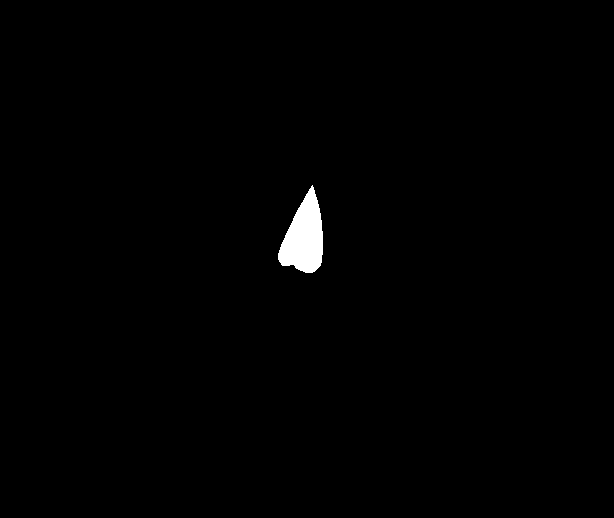

In [ ]:
# ตัวอย่าง Segmentation (จาก JSON)
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

array([[[189, 189, 189],
        [189, 189, 189],
        [190, 190, 190],
        ...,
        [166, 166, 166],
        [168, 168, 168],
        [168, 168, 168]],

       [[186, 186, 186],
        [187, 187, 187],
        [189, 189, 189],
        ...,
        [170, 170, 170],
        [170, 170, 170],
        [171, 171, 171]],

       [[185, 185, 185],
        [187, 187, 187],
        [188, 188, 188],
        ...,
        [172, 172, 172],
        [172, 172, 172],
        [173, 173, 173]],

       ...,

       [[173, 173, 173],
        [174, 174, 174],
        [172, 172, 172],
        ...,
        [118, 118, 118],
        [118, 118, 118],
        [116, 116, 116]],

       [[171, 171, 171],
        [169, 169, 169],
        [168, 168, 168],
        ...,
        [118, 118, 118],
        [118, 118, 118],
        [116, 116, 116]],

       [[173, 173, 173],
        [172, 172, 172],
        [171, 171, 171],
        ...,
        [113, 113, 113],
        [113, 113, 113],
        [113, 113, 113]]], dtype=uint8)
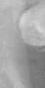

In [ ]:
# สร้าง Bounding Box รอบ Segmentation
x, y, w, h = cv2.boundingRect(points)

# ตัดพื้นที่ที่ต้องการสะท้อน
region_to_reflect = image[y:y+h, x-w:x]  # เลือกพื้นที่ก่อนฟัน (สำหรับสะท้อน)
region_to_reflect

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)
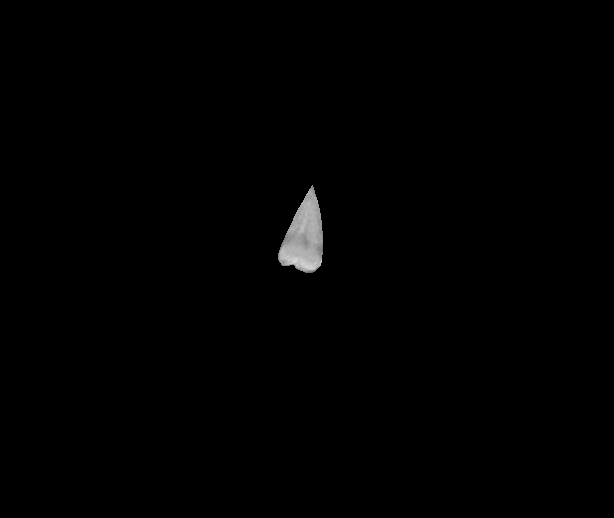

In [ ]:
cropped_tooth

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)
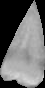

In [ ]:
tooth_region

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [219, 219, 219]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       ...,

       [[251, 251, 251],
        [240, 240, 240],
        [223, 223, 223],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[251, 251, 251],
        [242, 242, 242],
        [229, 229, 229],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[253, 253, 253],
        [247, 247, 247],
        [237, 237, 237],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]], dtype=uint8)
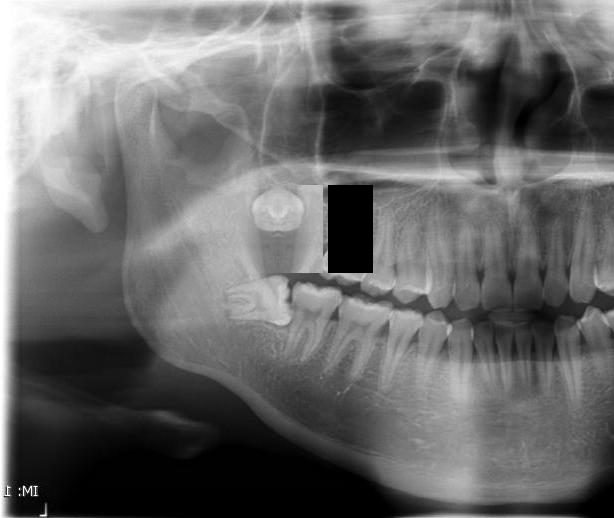

In [ ]:
image_without_tooth

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [219, 219, 219]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       ...,

       [[251, 251, 251],
        [240, 240, 240],
        [223, 223, 223],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[251, 251, 251],
        [242, 242, 242],
        [229, 229, 229],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[253, 253, 253],
        [247, 247, 247],
        [237, 237, 237],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]], dtype=uint8)
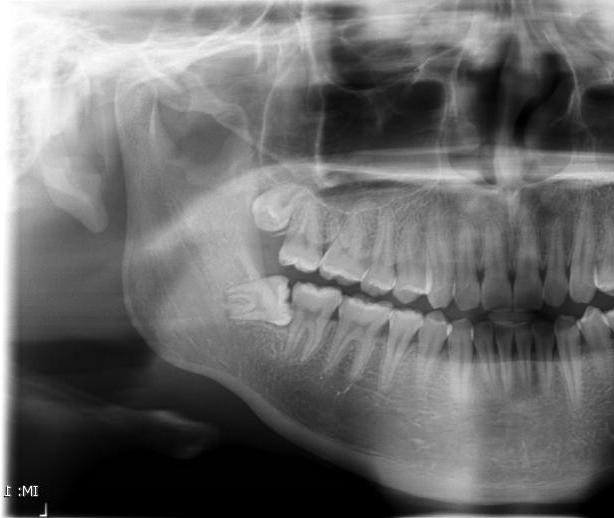

In [ ]:
image

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])

# ตัวอย่าง Segmentation (ตำแหน่งฟันที่ต้องการเลื่อน)
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# ตัดฟันออกจากภาพโดยใช้ Mask
cropped_tooth = cv2.bitwise_and(image, image, mask=mask)

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)
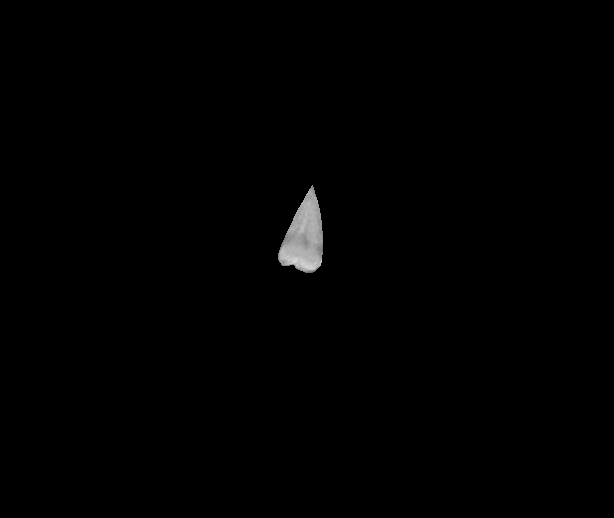

In [ ]:
cropped_tooth

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)
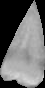

In [ ]:
# สร้าง Bounding Box ของฟัน
x, y, w, h = cv2.boundingRect(points)

# ครอบฟันที่ต้องการเลื่อน
tooth_region = cropped_tooth[y:y+h, x:x+w]
tooth_region

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [219, 219, 219]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       ...,

       [[251, 251, 251],
        [240, 240, 240],
        [223, 223, 223],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[251, 251, 251],
        [242, 242, 242],
        [229, 229, 229],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[253, 253, 253],
        [247, 247, 247],
        [237, 237, 237],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]], dtype=uint8)
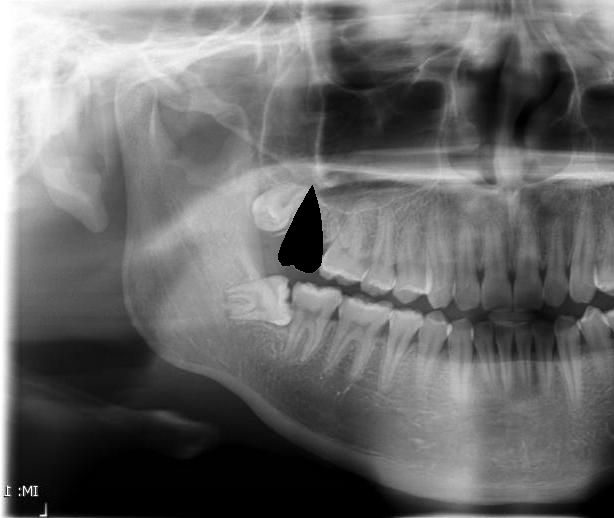

In [ ]:

# ลบฟันเดิมออกจากภาพ (ให้พื้นที่เป็นสีดำ)
inverse_mask = cv2.bitwise_not(mask)
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)
image_without_tooth

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)
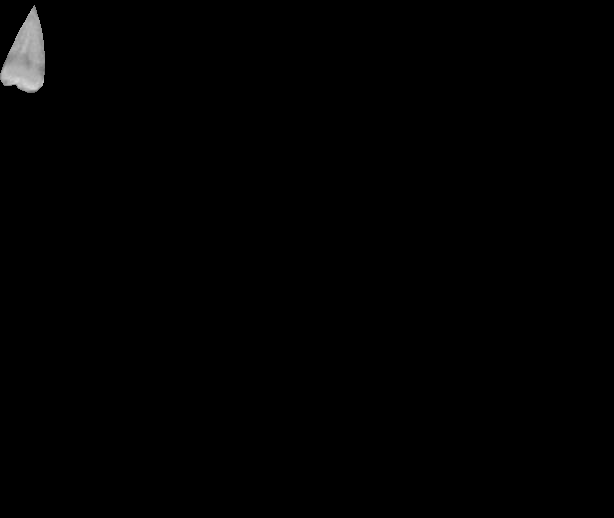

In [ ]:
# เลื่อนฟันไปตำแหน่งใหม่
dx, dy = 0, 5  # ระยะการเลื่อน (ไปทางขวา 50 px)
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])
moved_tooth = cv2.warpAffine(tooth_region, translation_matrix, (image.shape[1], image.shape[0]))
moved_tooth

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [219, 219, 219]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [220, 220, 220],
        [220, 220, 220],
        [220, 220, 220]],

       ...,

       [[251, 251, 251],
        [240, 240, 240],
        [223, 223, 223],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[251, 251, 251],
        [242, 242, 242],
        [229, 229, 229],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[253, 253, 253],
        [247, 247, 247],
        [237, 237, 237],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]], dtype=uint8)
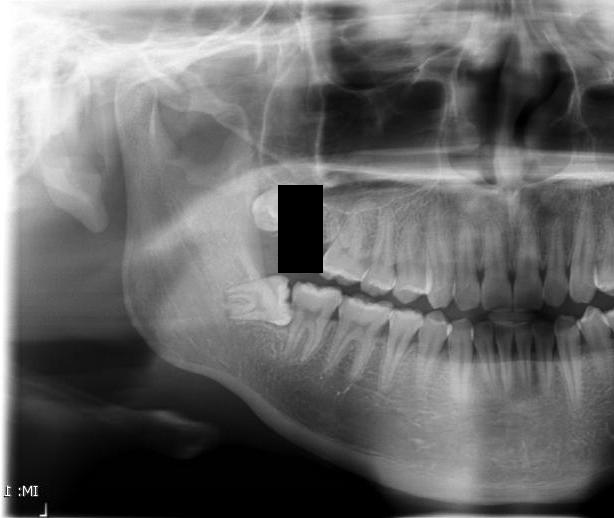

In [ ]:
# วางฟันที่เลื่อนไปในตำแหน่งใหม่
image_without_tooth[y:y+h, x+dx:x+dx+w] = moved_tooth[y:y+h, x+dx:x+dx+w]
image_without_tooth

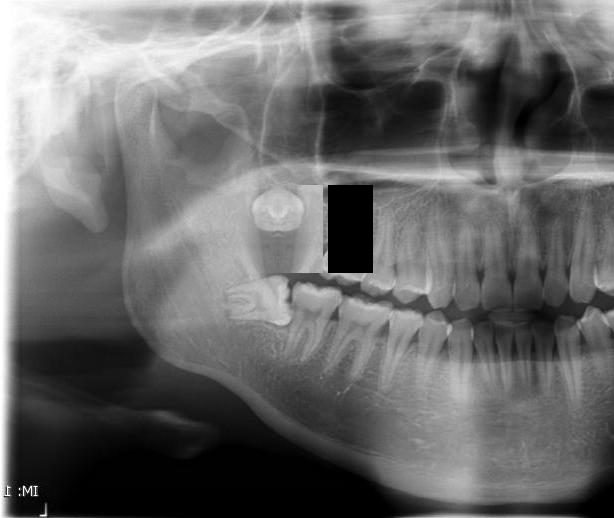

True

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# โหลดภาพต้นฉบับ
image = cv2.imread(aa['Path_Name'][0])

# ตัวอย่าง Segmentation (ตำแหน่งฟันที่ต้องการเลื่อน)
segmentation = aa['segmentation'][0][0]

# แปลง Segmentation เป็น Array ของจุด
points = np.array(segmentation, dtype=np.int32).reshape(-1, 2)

# สร้าง Mask สำหรับฟัน
mask = np.zeros(image.shape[:2], dtype=np.uint8)
cv2.fillPoly(mask, [points], 255)

# ตัดฟันออกจากภาพโดยใช้ Mask
cropped_tooth = cv2.bitwise_and(image, image, mask=mask)

# สร้าง Bounding Box ของฟัน
x, y, w, h = cv2.boundingRect(points)

# ครอบฟันที่ต้องการเลื่อน
tooth_region = cropped_tooth[y:y+h, x:x+w]

# ลบฟันเดิมออกจากภาพ (ให้พื้นที่เป็นสีดำ)
inverse_mask = cv2.bitwise_not(mask)
image_without_tooth = cv2.bitwise_and(image, image, mask=inverse_mask)

# เลื่อนฟันไปตำแหน่งใหม่
dx, dy = 50, 0  # ระยะการเลื่อน (ไปทางขวา 50 px)
translation_matrix = np.float32([[1, 0, dx], [0, 1, dy]])
moved_tooth = cv2.warpAffine(tooth_region, translation_matrix, (image.shape[1], image.shape[0]))

# วางฟันที่เลื่อนไปในตำแหน่งใหม่
image_without_tooth[y:y+h, x+dx:x+dx+w] = moved_tooth[y:y+h, x+dx:x+dx+w]

# เติมพื้นที่ว่างด้วยการสะท้อน
region_to_reflect = image[y:y+h, x-w:x]  # พื้นที่ด้านซ้ายของฟัน
reflected_region = cv2.flip(region_to_reflect, 1)  # สะท้อนแนวนอน

# เติมภาพสะท้อนในพื้นที่ว่างเดิม
image_without_tooth[y:y+h, x:x+w] = reflected_region

# แสดงผลลัพธ์
cv2_imshow(image_without_tooth)

# บันทึกผลลัพธ์
cv2.imwrite("image_with_moved_and_reflected_tooth_fixed.jpg", image_without_tooth)
